<a href="https://www.kaggle.com/code/heemalichaudhari/tabular-playground-series-extensive-eda?scriptVersionId=116138444" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# In this notebook, I'm going to try to explain all the codes so that beginners would find it easy to understand everything about the code as well on how to participate in a competition as well.

This code installs the 'swifter' library using pip, which is a package manager for Python. It then uses the clear_output() function from the IPython.display module to clear the output of the current cell.

In [1]:
!pip install swifter
from IPython.display import clear_output;
clear_output();

# Importing required libraries:

In [2]:
import numpy as np;
import pandas as pd;
import swifter;
from termcolor import colored;
import matplotlib.pyplot as plt;
%matplotlib inline
import seaborn as sns;
from scipy.stats import skew, iqr;

from warnings import filterwarnings;
filterwarnings(action= 'ignore');
from gc import collect;
from tqdm.notebook import tqdm;

np.random.seed(10);

This code is importing the `"patch_sklearn"` function from the "sklearnex" package and calling it to add the functionality provided by the package to scikit-learn.
It is also importing two modules from scikit-learn library:

`KFold` : class to generate KFold cross-validator which will split the data into K folds.

`mean_squared_error` : It is used to measure the mean squared error between the predicted values and the true values





In [3]:
from sklearnex import patch_sklearn; patch_sklearn()
from sklearn.model_selection import KFold;
from sklearn.metrics import mean_squared_error;

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


# Training data:

This code is using the Pandas library to read in two CSV files: 'data.csv' and 'sample_submission.csv' using pd.read_csv() function. The first file is read into a dataframe called "xytrain", and the second file is read into a dataframe called "sub_fl".
The encoding parameter is specified as 'utf8', and the index_col parameter is specified as 'row_id' for the first file read, which sets the 'row_id' column as the index for the DataFrame.

It is then using the print() function to print the string "Training data" in blue and bold font. It is displaying the first 5 rows of xytrain DataFrame using the display() function, and applies the .style.format(precision=2) attribute to it, Which sets the precision of the float values to 2 decimal places.

similarly it is displaying the first 5 rows of sub_fl DataFrame using the display() function, and applies the .style.format(precision=2) attribute to it.
It is also printing the string "Sample submission data" in blue and bold font.

In [4]:
xytrain = pd.read_csv('/kaggle/input/tabular-playground-series-jun-2022/data.csv', 
                      encoding = 'utf8', index_col= 'row_id');
sub_fl = pd.read_csv('/kaggle/input/tabular-playground-series-jun-2022/sample_submission.csv', 
                     encoding= 'utf8');

print(colored(f"\nTraining data\n", color = 'blue', attrs= ['bold']));
display(xytrain.head(5).style.format(precision=2));

print(colored(f"\nSample submission data\n", color = 'blue', attrs= ['bold']));
display(sub_fl.head(5).style.format(precision= 2));


Training data



,F_1_0,F_1_1,F_1_2,F_1_3,F_1_4,F_1_5,F_1_6,F_1_7,F_1_8,F_1_9,F_1_10,F_1_11,F_1_12,F_1_13,F_1_14,F_2_0,F_2_1,F_2_2,F_2_3,F_2_4,F_2_5,F_2_6,F_2_7,F_2_8,F_2_9,F_2_10,F_2_11,F_2_12,F_2_13,F_2_14,F_2_15,F_2_16,F_2_17,F_2_18,F_2_19,F_2_20,F_2_21,F_2_22,F_2_23,F_2_24,F_3_0,F_3_1,F_3_2,F_3_3,F_3_4,F_3_5,F_3_6,F_3_7,F_3_8,F_3_9,F_3_10,F_3_11,F_3_12,F_3_13,F_3_14,F_3_15,F_3_16,F_3_17,F_3_18,F_3_19,F_3_20,F_3_21,F_3_22,F_3_23,F_3_24,F_4_0,F_4_1,F_4_2,F_4_3,F_4_4,F_4_5,F_4_6,F_4_7,F_4_8,F_4_9,F_4_10,F_4_11,F_4_12,F_4_13,F_4_14
row_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,-0.35,-0.46,2.30,0.73,1.70,0.14,-0.52,0.50,-1.85,-0.50,-1.42,1.20,0.55,-0.76,nan,2,2,0,3,2,1,1,3,2,2,3,3,2,5,4,1,0,1,0,2,1,2,0,1,2,-0.24,0.06,0.56,-0.17,-0.43,0.47,0.60,0.82,1.48,1.26,-1.12,0.76,-0.09,-0.62,0.06,1.08,-0.78,-1.94,-0.72,0.60,0.50,0.12,-0.23,nan,0.30,5.55,1.07,-0.13,-0.10,-0.66,3.74,0.79,0.27,-0.56,0.20,0.37,6.21,3.81,1.24,1.18
1,1.38,-0.50,-0.42,1.91,-0.83,-1.72,-0.58,-1.04,0.60,-0.36,-0.85,0.67,0.84,-0.04,0.26,3,5,2,1,4,2,3,2,0,0,9,3,1,4,1,2,1,0,1,1,1,1,3,2,5,-0.45,1.43,0.04,-1.99,-0.60,-0.61,-1.15,0.07,0.35,-0.84,1.17,0.92,-0.84,0.76,-1.55,0.72,-0.94,1.80,-1.05,-0.58,0.70,0.38,0.71,0.03,nan,-1.71,-1.19,-0.56,-1.46,1.29,-2.90,-0.74,2.36,-0.06,0.73,-0.27,5.23,-4.22,-2.72,-0.06
2,0.26,-1.06,nan,0.35,1.51,1.24,-0.51,-0.80,-0.12,0.60,-0.07,-1.38,-0.11,0.70,-0.46,3,2,1,3,2,1,0,6,1,1,3,4,1,2,2,1,2,2,4,8,1,5,1,2,4,-0.77,0.48,-0.64,-1.31,-2.09,0.28,-1.21,-0.86,0.23,0.22,-1.03,0.58,-0.31,-0.50,0.49,0.92,-0.51,0.90,-0.06,0.21,-0.57,-1.52,-0.89,0.14,1.00,1.91,3.88,nan,0.36,0.44,2.25,0.47,2.49,0.35,-0.26,-0.00,-0.12,-2.13,3.66,-0.13
3,-0.73,-2.43,-2.45,-0.02,0.33,0.09,-1.79,0.67,0.76,-2.22,-0.62,0.74,0.49,0.74,-0.77,2,3,2,1,1,1,2,0,6,2,6,2,1,1,2,3,1,2,1,2,6,2,1,0,2,-0.69,-1.00,0.87,0.46,nan,0.50,0.20,-0.45,-1.23,0.90,1.14,-1.48,-0.41,0.02,-0.98,0.18,-0.94,-1.92,1.51,0.60,0.58,-0.12,-0.71,0.23,1.00,-2.64,0.55,0.87,-0.86,2.67,2.00,-4.66,-0.85,-0.26,0.66,-0.56,8.50,-4.74,-3.05,0.49
4,0.59,-0.07,0.47,-1.10,0.12,-1.81,0.47,-0.05,-0.58,-1.14,1.34,1.19,1.04,-0.76,0.51,5,0,1,3,3,0,2,5,1,3,5,5,4,4,2,0,2,3,2,5,2,2,1,0,4,1.20,1.08,0.49,0.42,0.48,0.43,-1.67,-0.84,1.01,-0.70,-0.89,1.49,-0.15,1.26,2.43,0.88,0.59,0.38,0.67,-0.66,1.28,nan,-1.28,-0.77,1.85,-0.23,-0.46,1.13,-0.75,nan,0.98,2.56,3.38,0.85,0.70,0.55,-5.98,-2.87,3.73,-0.72



Sample submission data



,row-col,value
0,0-F_1_14,0.00
1,0-F_3_23,0.00
2,1-F_3_24,0.00
3,2-F_1_2,0.00
4,2-F_4_2,0.00


This code is using the print() function to print the string "Training data information" in blue and bold font.
It then uses the DataFrame's info() method to display information about xytrain DataFrame such as

the number of rows and columns
the name and datatype of columns
Non-null values in the DataFrame
It then does the same for the sub_fl DataFrame, printing the string "Submission file information" in blue and bold font, and then calling the info() method to display information about the sub_fl DataFrame.
This is used for general understanding about the Dataframe, it's Columns, their datatype, the number of non-null records, memory usage etc





In [5]:
print(colored(f"\nTraining data information\n", color = 'blue', attrs= ['bold']));
display(xytrain.info());

print(colored(f"\nSubmission file information\n", color = 'blue', attrs= ['bold']));
display(sub_fl.info());


Training data information

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000000 entries, 0 to 999999
Data columns (total 80 columns):
 #   Column  Non-Null Count    Dtype  
---  ------  --------------    -----  
 0   F_1_0   981603 non-null   float64
 1   F_1_1   981784 non-null   float64
 2   F_1_2   981992 non-null   float64
 3   F_1_3   981750 non-null   float64
 4   F_1_4   981678 non-null   float64
 5   F_1_5   981911 non-null   float64
 6   F_1_6   981867 non-null   float64
 7   F_1_7   981872 non-null   float64
 8   F_1_8   981838 non-null   float64
 9   F_1_9   981751 non-null   float64
 10  F_1_10  982039 non-null   float64
 11  F_1_11  981830 non-null   float64
 12  F_1_12  981797 non-null   float64
 13  F_1_13  981602 non-null   float64
 14  F_1_14  981961 non-null   float64
 15  F_2_0   1000000 non-null  int64  
 16  F_2_1   1000000 non-null  int64  
 17  F_2_2   1000000 non-null  int64  
 18  F_2_3   1000000 non-null  int64  
 19  F_2_4   1000000 non-null  int64  
 2

None


Submission file information

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 2 columns):
 #   Column   Non-Null Count    Dtype  
---  ------   --------------    -----  
 0   row-col  1000000 non-null  object 
 1   value    1000000 non-null  float64
dtypes: float64(1), object(1)
memory usage: 15.3+ MB


None

# Memory Reduction

This code defines a function called "ReduceMemory()" that takes in a DataFrame as an input.
This function is used to reduce memory usage of the DataFrame, by changing the datatype of the columns.

The function starts with a for-loop that iterates over all the columns in the DataFrame that have a data type of 'float' and are selected by the Dataframe's select_dtypes('float') method. It calculates the minimum and maximum values of the column, col_min and col_max respectively.

Then it uses the numpy functions `np.finfo(np.float16)` and `np.finfo(np.float32)` to get the minimum and maximum values of a float16 and float32 respectively, and check if the column's min value is greater than or equal to the min value of float16, and the column's max value is less than or equal to the max value of float16, then it changes the column's data type to float16,
else if the column's min value is greater than or equal to the min value of float32, and the column's max value is less than or equal to the max value of float32, then it changes the column's data type to float32, otherwise the column's data type will not be changed.

It does the same thing for integer columns by selecting the columns of datatype 'int' using select_dtypes('int') method and then checking for the min and max values of the columns, then it checks the range of different integer data types and assign them accordingly to the columns.

It then prints the string "Dataframe information after memory reduction" in blue and bold font, and then it calls the DataFrame's info() method to display the new information about the DataFrame, after the reduction of memory usage.

Finally, it returns the modified DataFrame.





In [6]:
def ReduceMemory(df: pd.DataFrame):
    for col in tqdm(df.iloc[0:2, 1:].select_dtypes('float').columns):
        col_min = np.amin(df[col].dropna());
        col_max = np.amax(df[col].dropna());
        
        if col_min >= np.finfo(np.float16).min and col_max <= np.finfo(np.float16).max: 
            df[col] = df[col].astype(np.float16)
        elif col_min >= np.finfo(np.float32).min and col_max <= np.finfo(np.float32).max : 
            df[col] = df[col].astype(np.float32)
        else: pass;

    # Reducing integer column memory usage:-
    for col in tqdm(df.iloc[0:2, 1:].select_dtypes('int').columns):
        col_min = df[col].min(); 
        col_max = df[col].max();
        
        if col_min >= np.iinfo(np.int8).min and col_max <= np.iinfo(np.int8).max:
            df[col] = df[col].astype(np.int8);
        elif col_min >= np.iinfo(np.int16).min and col_max <= np.iinfo(np.int16).max:
            df[col] = df[col].astype(np.int16);
        elif col_min >= np.iinfo(np.int32).min & col_max <= np.iinfo(np.int32).max:
            df[col] = df[col].astype(np.int32);
        else: pass;
        
    print(colored(f"\nDataframe information after memory reduction\n", 
                  color = 'blue', attrs= ['bold']));
    display(df.info()); 
    
    return df;

In [7]:
xytrain = ReduceMemory(df= xytrain);
sub_fl = ReduceMemory(df= sub_fl);
collect();

  0%|          | 0/54 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]


Dataframe information after memory reduction

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000000 entries, 0 to 999999
Data columns (total 80 columns):
 #   Column  Non-Null Count    Dtype  
---  ------  --------------    -----  
 0   F_1_0   981603 non-null   float64
 1   F_1_1   981784 non-null   float16
 2   F_1_2   981992 non-null   float16
 3   F_1_3   981750 non-null   float16
 4   F_1_4   981678 non-null   float16
 5   F_1_5   981911 non-null   float16
 6   F_1_6   981867 non-null   float16
 7   F_1_7   981872 non-null   float16
 8   F_1_8   981838 non-null   float16
 9   F_1_9   981751 non-null   float16
 10  F_1_10  982039 non-null   float16
 11  F_1_11  981830 non-null   float16
 12  F_1_12  981797 non-null   float16
 13  F_1_13  981602 non-null   float16
 14  F_1_14  981961 non-null   float16
 15  F_2_0   1000000 non-null  int8   
 16  F_2_1   1000000 non-null  int8   
 17  F_2_2   1000000 non-null  int8   
 18  F_2_3   1000000 non-null  int8   
 19  F_2_4   1000000 n

None

  0%|          | 0/1 [00:00<?, ?it/s]

0it [00:00, ?it/s]


Dataframe information after memory reduction

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 2 columns):
 #   Column   Non-Null Count    Dtype  
---  ------   --------------    -----  
 0   row-col  1000000 non-null  object 
 1   value    1000000 non-null  float16
dtypes: float16(1), object(1)
memory usage: 9.5+ MB


None

# Exploratory Data Analysis

In [8]:
# Model data description:-
print(colored(f"\nModel data description with null values per column\n", 
              color = 'blue', attrs= ['bold']));

xytrain_desc_sum = \
pd.concat((xytrain.describe(percentiles= np.arange(0.10,1.0,0.10)).transpose(),
           xytrain.isna().sum(axis=0),
           xytrain.nunique(axis=0),
           pd.DataFrame(data= skew(xytrain.dropna(), axis=0),
                        index= xytrain.columns, columns= ['skewness'])), 
                  axis=1).\
rename({0: 'nb_null_values',1: 'nb_unique_values'}, axis=1);

display(xytrain_desc_sum.style.format('{:,.2f}'));



Model data description with null values per column



,count,mean,std,min,10%,20%,30%,40%,50%,60%,70%,80%,90%,max,nb_null_values,nb_unique_values,skewness
F_1_0,"981,603.00",-0.00,1.00,-4.66,-1.28,-0.84,-0.52,-0.25,-0.00,0.25,0.52,0.84,1.28,5.04,"18,397.00","859,226.00",-0.00
F_1_1,"981,784.00",0.00,0.00,-4.79,-1.28,-0.84,-0.52,-0.25,0.00,0.26,0.53,0.84,1.28,5.04,"18,216.00","21,979.00",0.01
F_1_2,"981,992.00",0.00,0.00,-4.87,-1.28,-0.84,-0.52,-0.25,0.00,0.25,0.52,0.84,1.28,5.13,"18,008.00","21,981.00",0.00
F_1_3,"981,750.00",0.00,0.00,-5.05,-1.28,-0.84,-0.52,-0.25,0.00,0.25,0.52,0.84,1.28,5.46,"18,250.00","21,982.00",-0.00
F_1_4,"981,678.00",0.00,0.00,-5.36,-1.28,-0.84,-0.52,-0.25,0.00,0.26,0.53,0.84,1.29,4.86,"18,322.00","22,077.00",0.00
F_1_5,"981,911.00",0.00,0.00,-5.51,-1.28,-0.84,-0.52,-0.25,0.00,0.25,0.52,0.84,1.28,4.96,"18,089.00","21,992.00",0.01
F_1_6,"981,867.00",-0.00,0.00,-5.20,-1.28,-0.84,-0.52,-0.25,0.00,0.25,0.52,0.84,1.28,4.96,"18,133.00","22,158.00",-0.00
F_1_7,"981,872.00",-0.00,0.00,-6.99,-1.01,-0.63,-0.38,-0.18,0.00,0.17,0.35,0.55,0.80,2.53,"18,128.00","22,139.00",-0.59
F_1_8,"981,838.00",-0.00,0.00,-4.57,-1.28,-0.84,-0.52,-0.25,-0.00,0.25,0.52,0.84,1.28,4.89,"18,162.00","21,989.00",-0.00
F_1_9,"981,751.00",0.00,0.00,-5.00,-1.28,-0.84,-0.52,-0.25,0.00,0.25,0.53,0.84,1.28,4.79,"18,249.00","22,021.00",0.00


In [9]:
# Grouping the table columns into 4 groups based on the F_{nb} values:-
# Creating input column list:-
xytrain_col = xytrain.columns;

# Populating the feature groups with dictionary comprehension:-
Ftre_Grp_Dict = {i: xytrain_col[xytrain_col.str[0:3] == f"F_{i}"] for i in range(1,5,1)};
print(colored(f"\nModel data feature groups\n", color = 'blue', attrs= ['bold']));
display(Ftre_Grp_Dict);


Model data feature groups



{1: Index(['F_1_0', 'F_1_1', 'F_1_2', 'F_1_3', 'F_1_4', 'F_1_5', 'F_1_6', 'F_1_7',
        'F_1_8', 'F_1_9', 'F_1_10', 'F_1_11', 'F_1_12', 'F_1_13', 'F_1_14'],
       dtype='object'),
 2: Index(['F_2_0', 'F_2_1', 'F_2_2', 'F_2_3', 'F_2_4', 'F_2_5', 'F_2_6', 'F_2_7',
        'F_2_8', 'F_2_9', 'F_2_10', 'F_2_11', 'F_2_12', 'F_2_13', 'F_2_14',
        'F_2_15', 'F_2_16', 'F_2_17', 'F_2_18', 'F_2_19', 'F_2_20', 'F_2_21',
        'F_2_22', 'F_2_23', 'F_2_24'],
       dtype='object'),
 3: Index(['F_3_0', 'F_3_1', 'F_3_2', 'F_3_3', 'F_3_4', 'F_3_5', 'F_3_6', 'F_3_7',
        'F_3_8', 'F_3_9', 'F_3_10', 'F_3_11', 'F_3_12', 'F_3_13', 'F_3_14',
        'F_3_15', 'F_3_16', 'F_3_17', 'F_3_18', 'F_3_19', 'F_3_20', 'F_3_21',
        'F_3_22', 'F_3_23', 'F_3_24'],
       dtype='object'),
 4: Index(['F_4_0', 'F_4_1', 'F_4_2', 'F_4_3', 'F_4_4', 'F_4_5', 'F_4_6', 'F_4_7',
        'F_4_8', 'F_4_9', 'F_4_10', 'F_4_11', 'F_4_12', 'F_4_13', 'F_4_14'],
       dtype='object')}

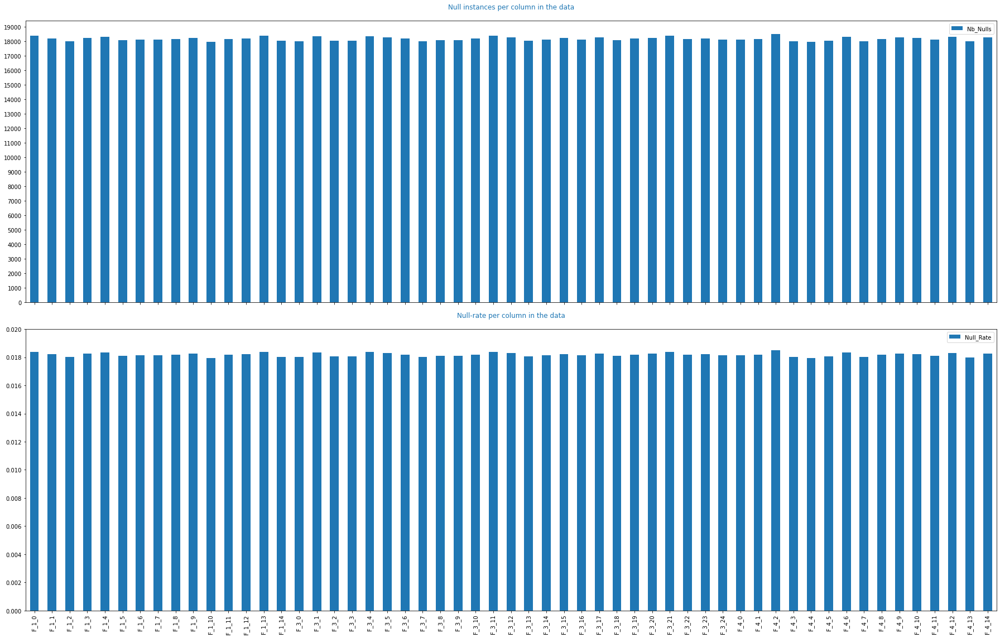

In [10]:
_ = pd.DataFrame(xytrain.isna().sum(axis=0), columns = ['Nb_Nulls']);
_['Null_Rate'] = _/ len(xytrain.index);

fig, ax = plt.subplots(2,1, figsize = (25,16), sharex= True);
_.loc[_['Nb_Nulls'] > 0, ['Nb_Nulls']].plot.bar(ax= ax[0], color = 'tab:blue');
ax[0].set_title(f"Null instances per column in the data\n", color = 'tab:blue', fontsize= 12);
ax[0].set_yticks(range(0,19001,1000));

_.loc[_['Nb_Nulls'] > 0, ['Null_Rate']].plot.bar(ax= ax[1], color = 'tab:blue');
ax[1].set_title(f"Null-rate per column in the data\n", color = 'tab:blue', fontsize= 12);
ax[1].set_yticks(np.arange(0.0, 0.022, 0.002));

plt.tight_layout();
plt.show();

del _;

In [11]:
# Analyzing the nulls per row only in feature group 4:-
def Locate_NullRows(df:pd.DataFrame, title: str):
    """
    This function locates the nulls across rows in the dataframe (or a subset) and plots it.
    Input:- 
    df (pd.DataFrame)- Analysis dataframe
    title (string)- Title for plots
    """;
    
    df['Nb_Nulls'] = df.isna().sum(axis=1);
    _ = pd.DataFrame(df.query("Nb_Nulls > 0").groupby(['Nb_Nulls']).size(),
                     columns = ['Nb_Nulls']);

    print(colored(f"\n{title}\n", color = 'blue', attrs= ['bold', 'dark']));
    display(_.style.format('{:,.0f}'));

    fig, ax= plt.subplots(1,1, figsize= (12,6));
    _.plot.bar(ax=ax);
    ax.set_title(f"\n{title}\n", color = 'tab:blue', fontsize= 12);
    ax.grid(visible= True, which = 'both', color = 'grey', linewidth= 0.75, linestyle= '--');
    ax.set_xlabel('Number of nulls', fontsize= 9);
    
    plt.tight_layout();
    plt.xticks(rotation= 0);
    plt.show();

    del _;
    df = df.drop(['Nb_Nulls'], axis=1);



Full table- nulls



,Nb_Nulls
Nb_Nulls,
1,"370,798"
2,"185,543"
3,"61,191"
4,"14,488"
5,"2,723"
6,413
7,64
8,4
9,2


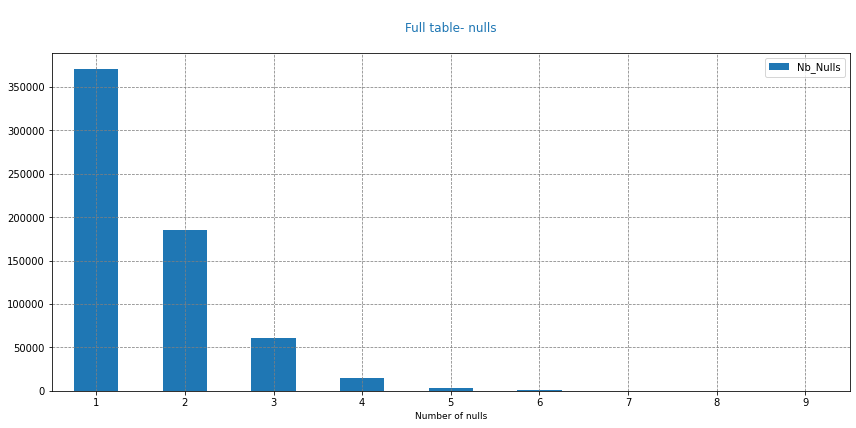


Feature group4- nulls



,Nb_Nulls
Nb_Nulls,
1,"211,342"
2,"27,127"
3,"2,124"
4,135
5,4


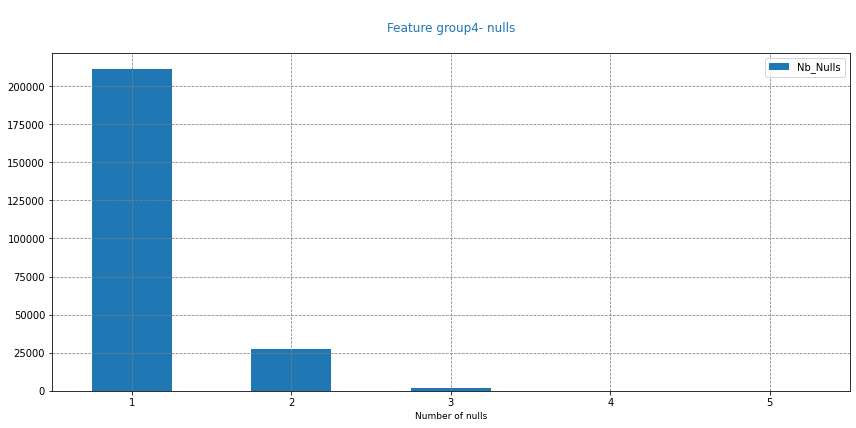

In [12]:
# Locating nulls across table components:-
Locate_NullRows(df= xytrain, title = 'Full table- nulls');
Locate_NullRows(df= xytrain.loc[:, Ftre_Grp_Dict.get(4)],title = 'Feature group4- nulls');
collect();


In [13]:
# Delving into group4 nulls to elicit model specifics:-
_ = xytrain.loc[:, list(Ftre_Grp_Dict.get(4))];
_['Nb_Nulls'] = _.isna().sum(axis=1);
_['Nb_Nulls'].astype(np.int8);

def EnlistNullCol(row):
    "This function forms a list of all columns in a row that contain null values";
    null_col_comb = [];
    for i in row.items(): 
        if np.isnan(i[1], casting= 'safe'): null_col_comb.append(i[0]);
    return ' '.join(null_col_comb);

_['Null_Col'] = _.swifter.apply(EnlistNullCol, axis=1);

print(colored(f"\nNull columns in feature group4-\n", color= 'blue', attrs= ['dark', 'bold']));
display(_.loc[_.Null_Col != '', ['Null_Col']].value_counts());
collect();

Dask Apply:   0%|          | 0/8 [00:00<?, ?it/s]


Null columns in feature group4-



Null_Col                 
F_4_2                        14248
F_4_6                        14201
F_4_10                       14198
F_4_0                        14175
F_4_9                        14166
                             ...  
F_4_2 F_4_8 F_4_9 F_4_12         1
F_4_2 F_4_8 F_4_9 F_4_14         1
F_4_3 F_4_4 F_4_5 F_4_10         1
F_4_3 F_4_4 F_4_6 F_4_13         1
F_4_2 F_4_6 F_4_11 F_4_14        1
Length: 703, dtype: int64

  0%|          | 0/5 [00:00<?, ?it/s]

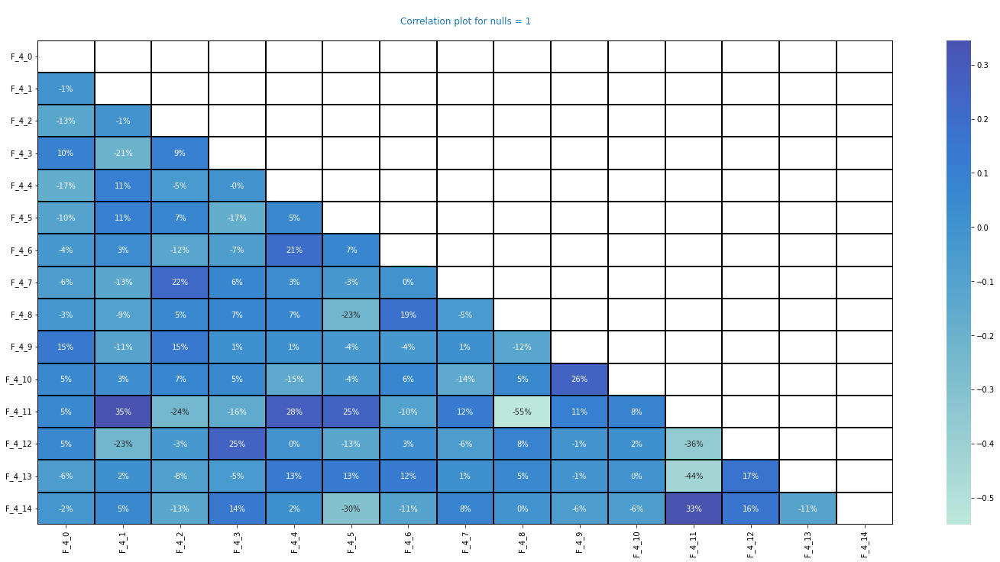

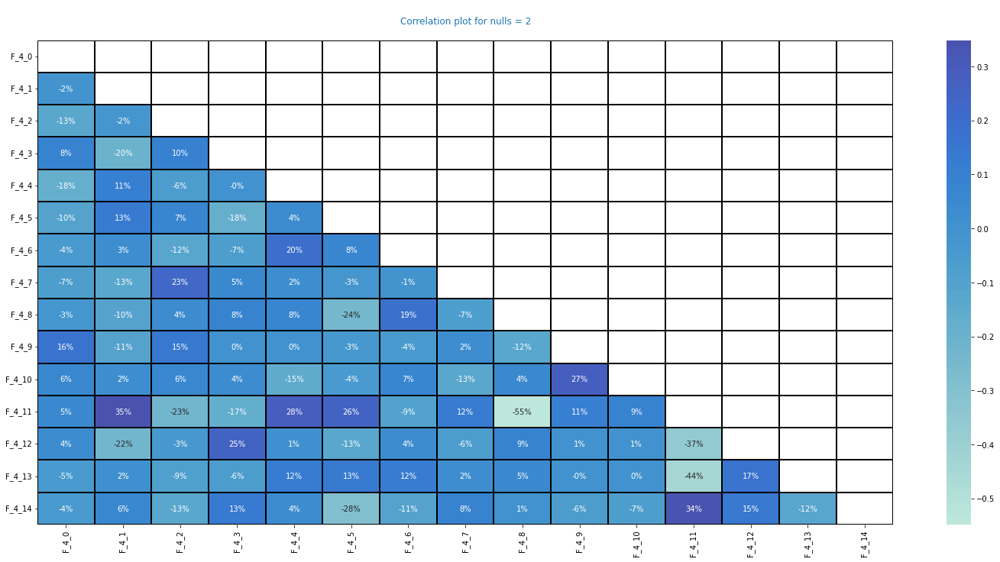

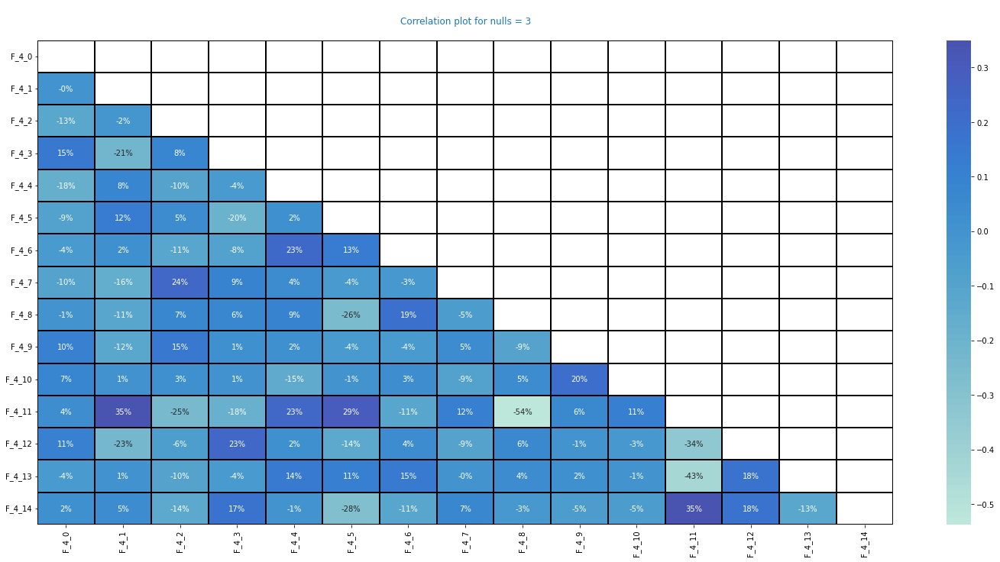

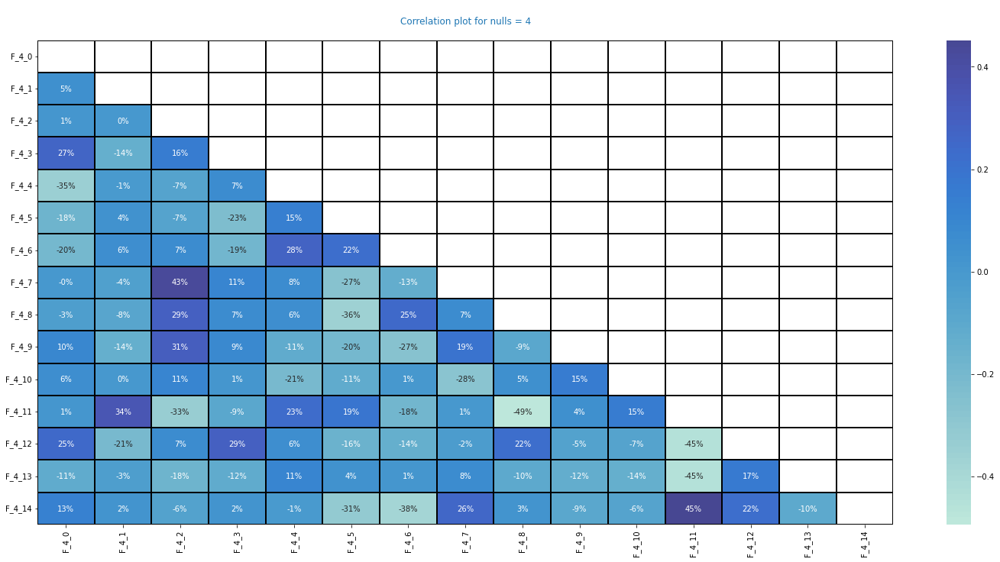

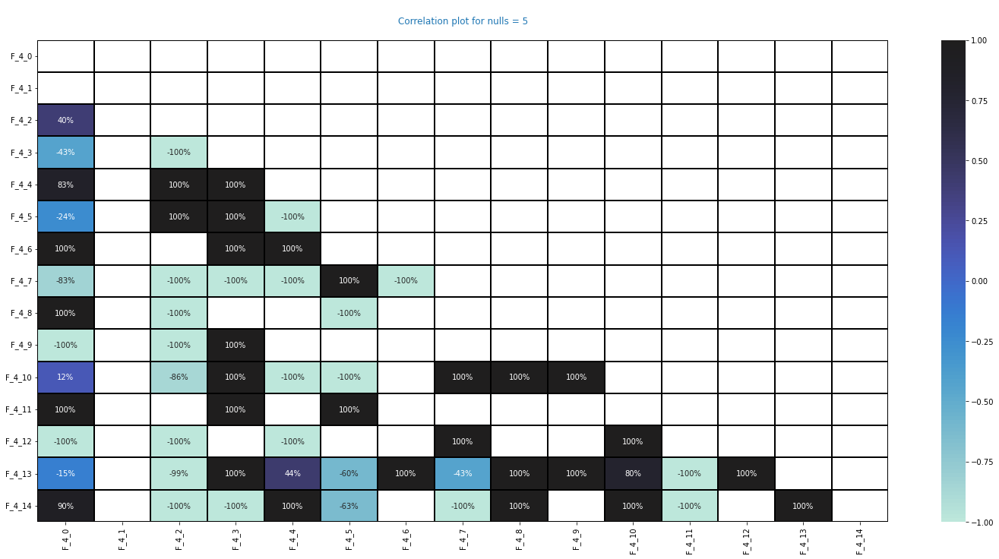

In [14]:
for nb_nulls in tqdm(range(1,6,1)):
    fig, ax= plt.subplots(1,1, figsize= (20,10));
    _corr = _.loc[_.Nb_Nulls == nb_nulls].drop(['Nb_Nulls', 'Null_Col'], axis=1).corr();
    sns.heatmap(_corr, annot= True, fmt= '.0%', linewidth= 0.35, center= True, cmap= 'icefire',
                linecolor= 'black', mask = np.triu(np.ones_like(_corr)),ax= ax);
    ax.set_title(f"\nCorrelation plot for nulls = {nb_nulls}\n", color= 'tab:blue');
    plt.tight_layout();
    plt.yticks(rotation= 0);
    plt.xticks(rotation= 90);
    plt.show();
    del _corr;
    collect();
    
del _;
collect();

  0%|          | 0/3 [00:00<?, ?it/s]


Distributions for feature group 1



0it [00:00, ?it/s]

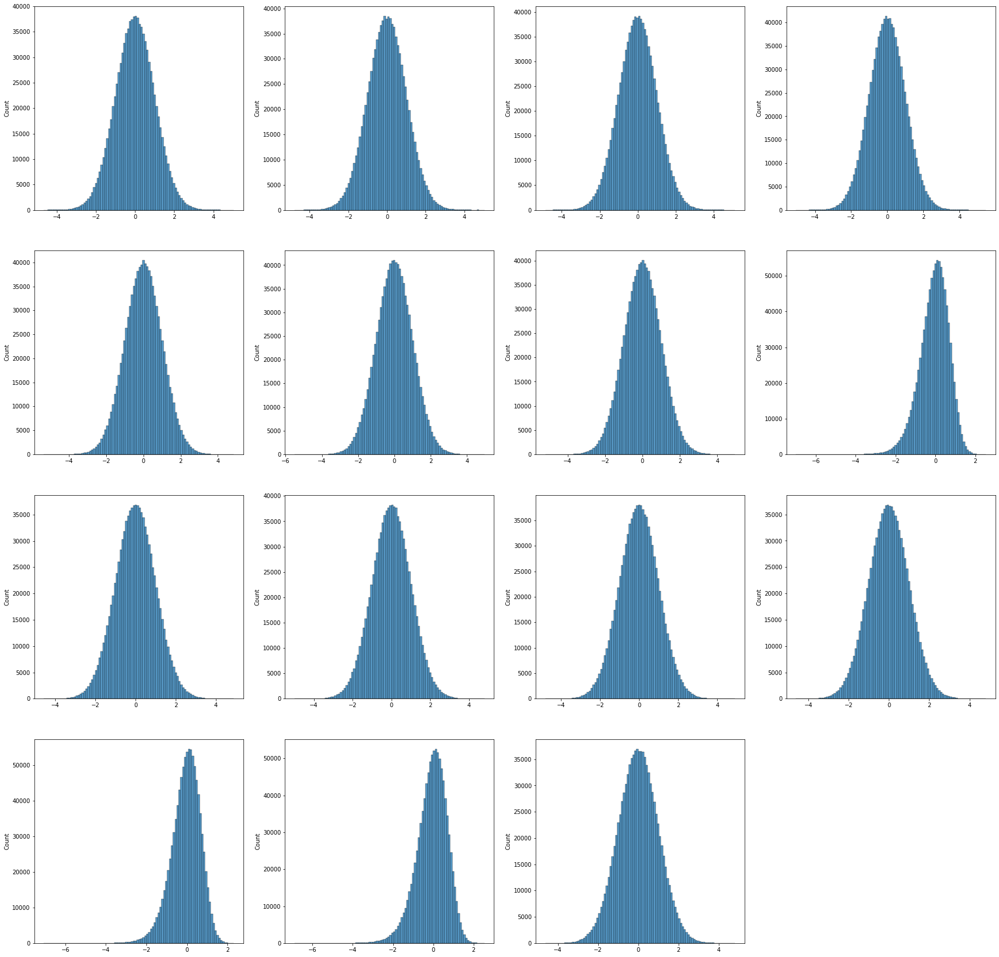


Distributions for feature group 3



0it [00:00, ?it/s]

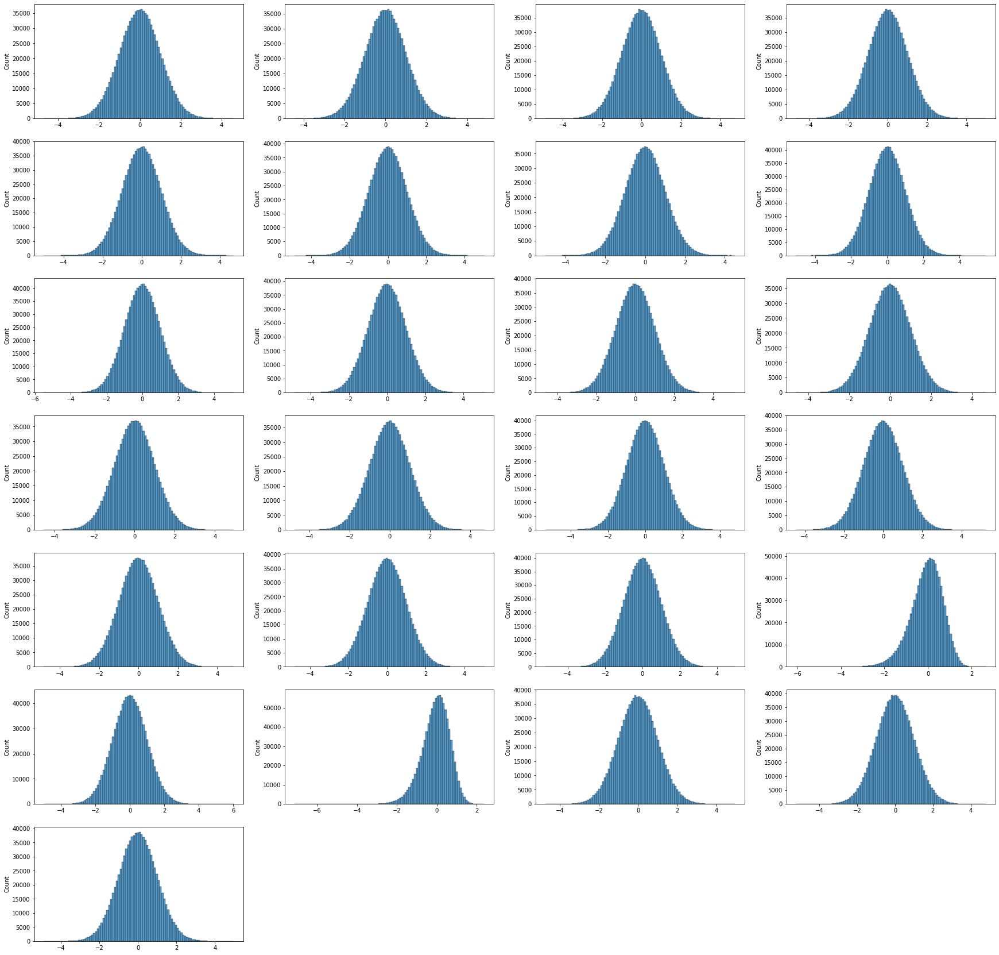


Distributions for feature group 4



0it [00:00, ?it/s]

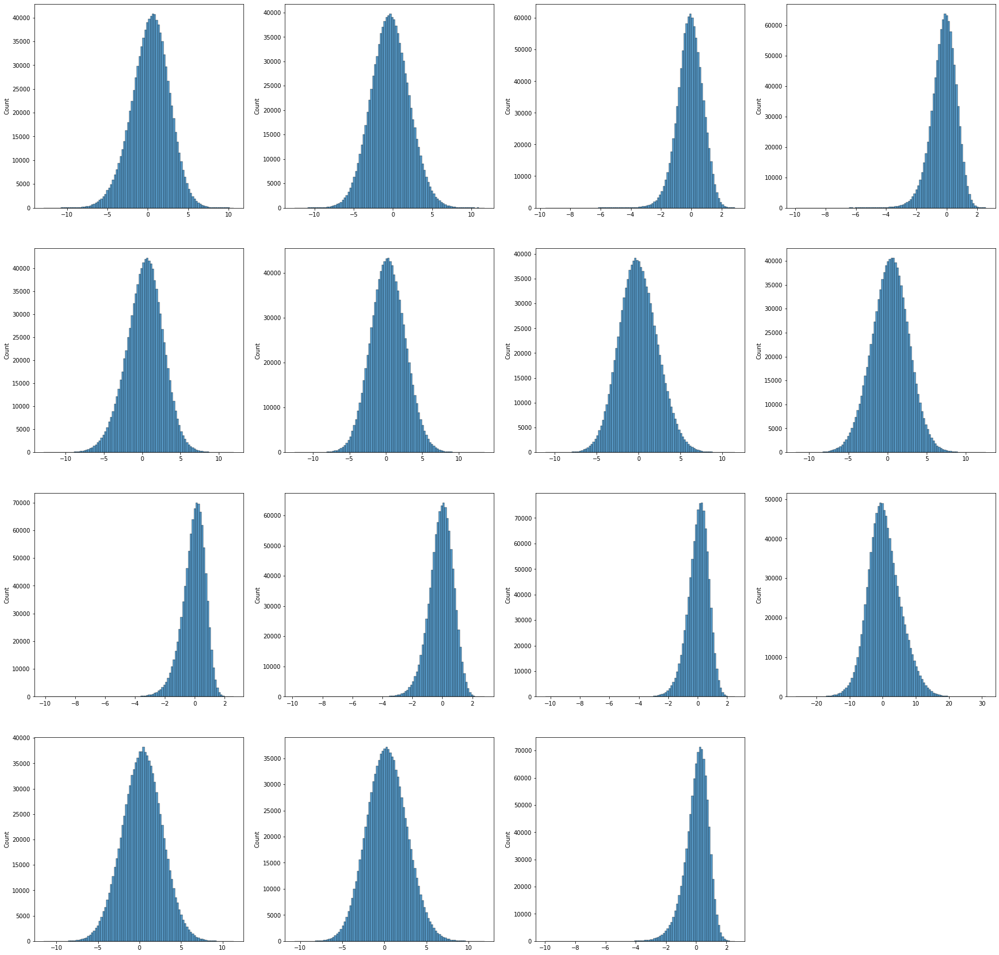

In [15]:
# Analyzing the data distributions per column group with continuous columns:-
for ftre_grp_nb in tqdm([1,3,4]):
    fig, axes = plt.subplots(1,1, figsize= (30,30));

    nplots= len(Ftre_Grp_Dict[ftre_grp_nb]);
    ncols= 4;
    nrows= int(np.ceil(nplots/ ncols));
    
    print(colored(f"\nDistributions for feature group {ftre_grp_nb}\n", 
                  color= 'blue', attrs= ['bold']));
    for i , col in tqdm(enumerate(Ftre_Grp_Dict[ftre_grp_nb])):
        plt.subplot(nrows, ncols, i+1);
        sns.histplot(x=xytrain[col].values, bins=100, color = 'tab:blue');
    plt.show();

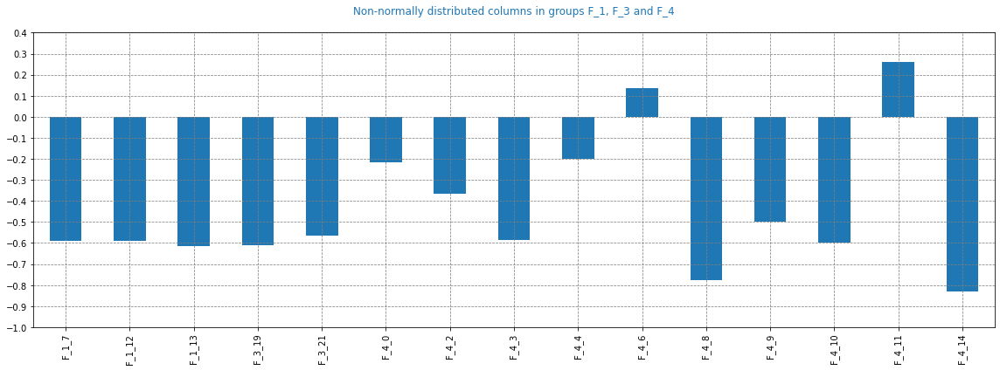

In [16]:
fig,ax= plt.subplots(1,1, figsize= (16,6));
xytrain_desc_sum.loc[(np.abs(xytrain_desc_sum.skewness) >= 0.10) 
                     & (xytrain_desc_sum.index.str[0:3] != 'F_2'), 'skewness'].plot.bar(ax=ax);
ax.set_title(f"Non-normally distributed columns in groups F_1, F_3 and F_4\n", 
             color= 'tab:blue', fontsize= 12);
ax.grid(visible= True, which= 'both', color= 'grey', linestyle = '--', linewidth= 0.75);
ax.set_yticks(np.arange(-1.0, 0.50, 0.1), fontsize= 8);

plt.tight_layout();
plt.show();


Value-counts for feature group 2



0it [00:00, ?it/s]

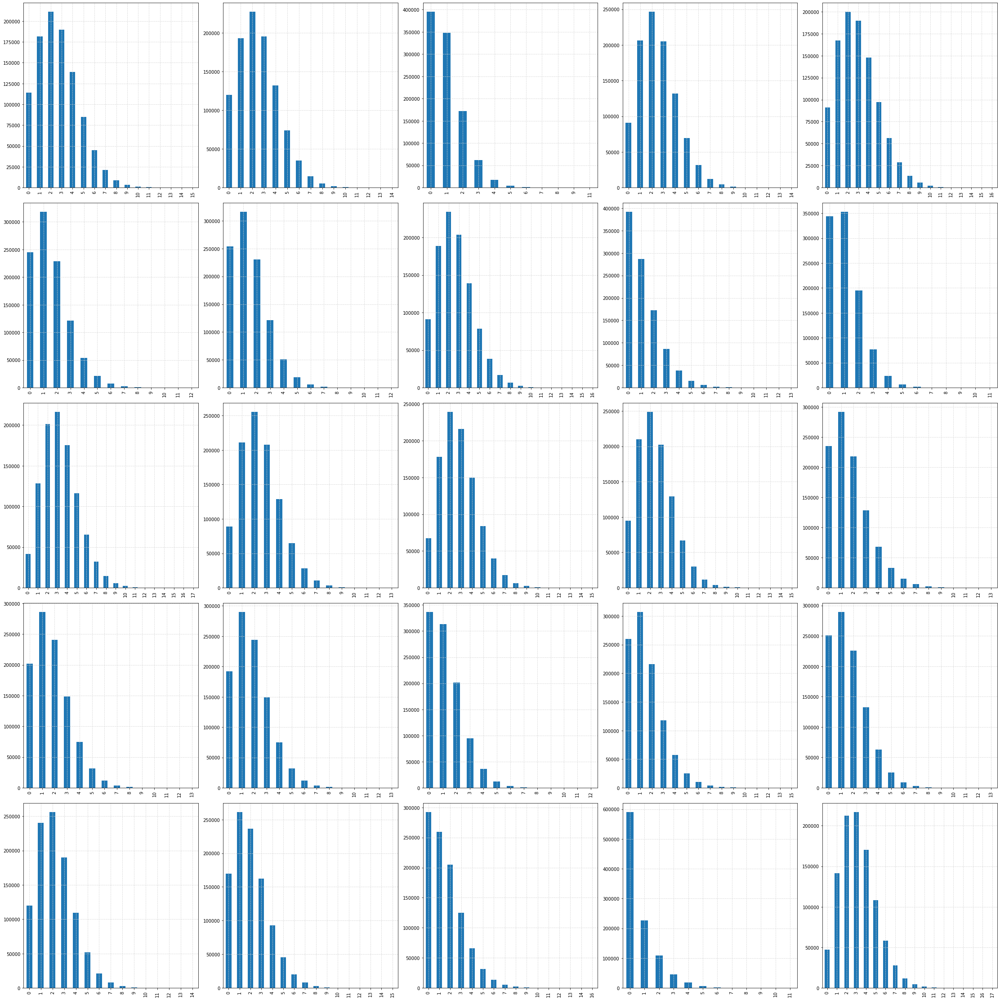

In [17]:
# Analyzing discrete column distributions in group 2:-
print(colored(f"Value-counts for feature group 2\n", color= 'blue', attrs= ['bold']));
fig, axes = plt.subplots(5,5, figsize= (31,31));

for i, col in tqdm(enumerate(Ftre_Grp_Dict.get(2))):
    xytrain[col].value_counts().sort_index(ascending= True).plot.bar(ax=axes[i//5, i%5]);
    axes[i//5, i%5].grid(visible= True, which= 'both', color= 'lightgrey', 
                         linewidth = 0.75, linestyle= '--');
    axes[i//5, i%5].set(xlabel= '', ylabel='');
plt.tight_layout();
plt.show();

  0%|          | 0/3 [00:00<?, ?it/s]

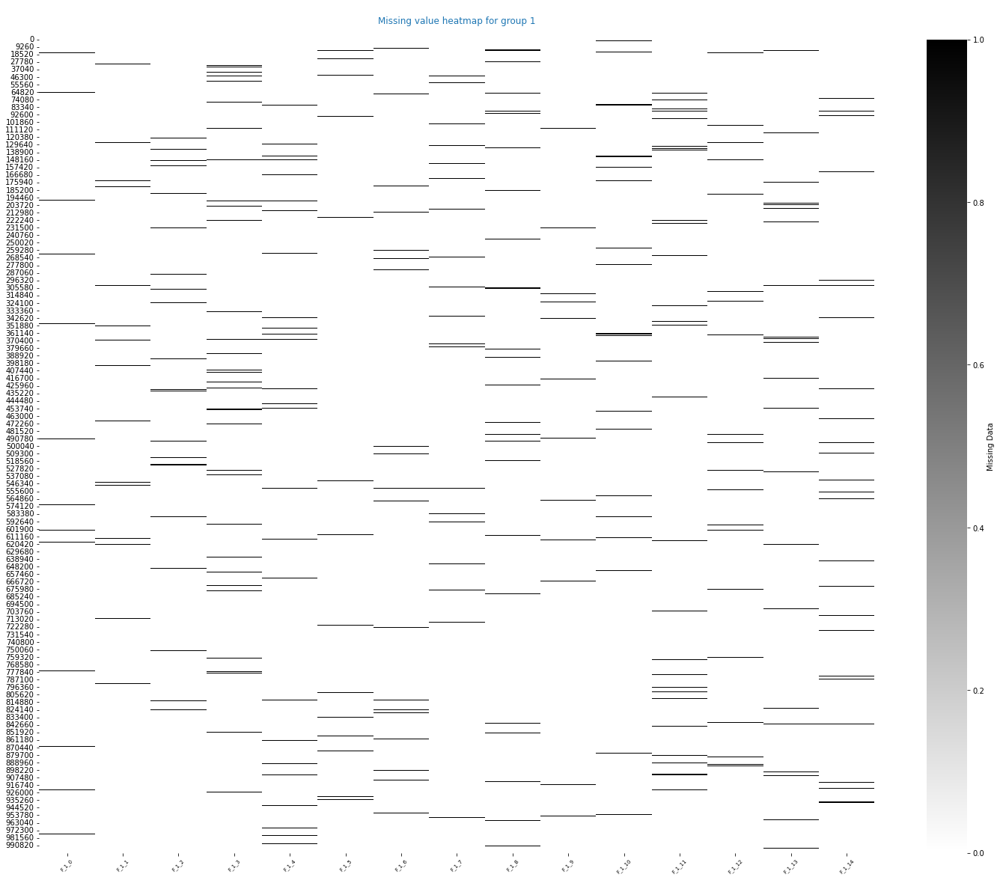

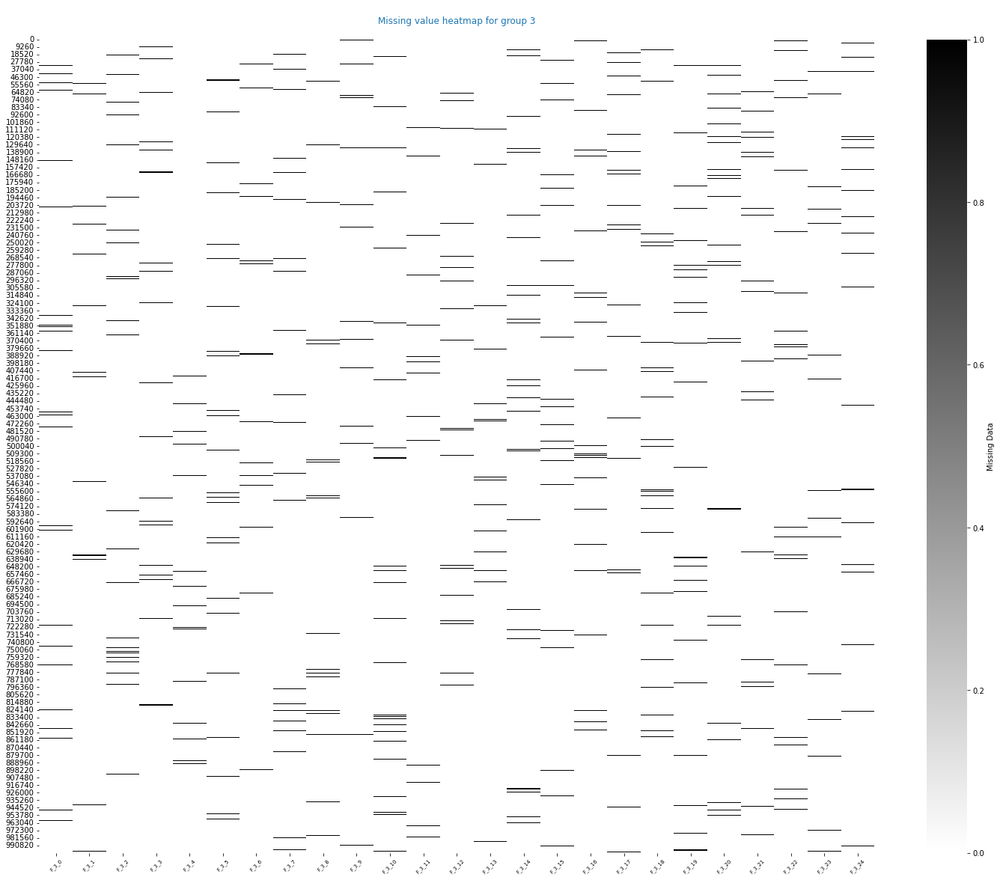

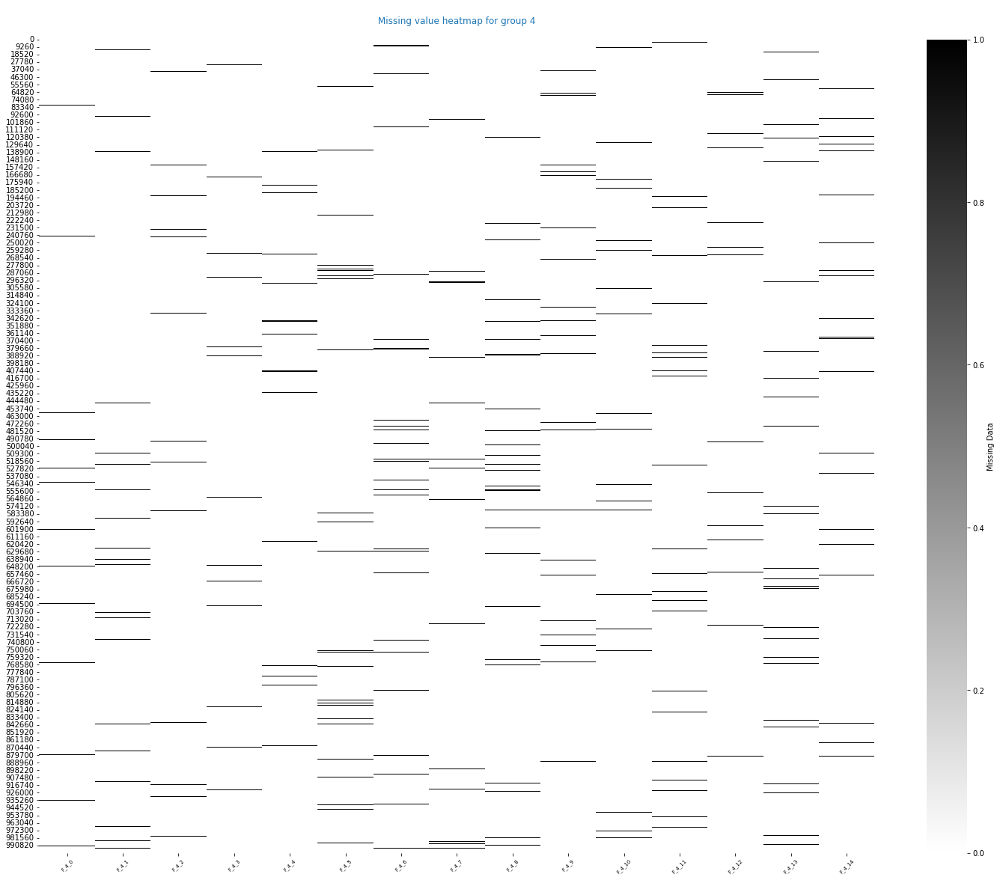

In [18]:
# Plotting the positions of nulls in the data-set:-
for i in tqdm([1,3,4]):
    fig, ax= plt.subplots(1,1, figsize= (25,20));
    sns.heatmap(data= xytrain[Ftre_Grp_Dict[i]].isna(), 
                cmap= 'binary', cbar_kws={'label': 'Missing Data'},ax= ax);
    ax.set_title(f"\nMissing value heatmap for group {i}\n", fontsize= 12, color= 'tab:blue');
    ax.set(ylabel='');
    plt.xticks(rotation = 45, fontsize= 7);
    plt.show();


In [19]:
def Plot_Ftre(grp_nb: np.int8, color: str= 'blue', sample_size: list= [100,1000,10000]):

    
    print(colored(f"Feature group {grp_nb} lineplots\n", color = 'green', attrs= ['dark', 'bold']));

    for chunk_size in tqdm(sample_size):
        print(colored(f"\nCurrent chunk size = {chunk_size}\n", color = 'red', attrs= ['dark', 'bold']));

        for ftre in tqdm(Ftre_Grp_Dict.get(4)):
            y= xytrain['F_4_0'].dropna()[0:chunk_size];
            fig, ax= plt.subplots(1,1, figsize= (25, 7.5));
            sns.lineplot(y= y, x= y.index, color = color, linestyle= '-', linewidth = 1.0, ax= ax);
            ax.set_title(f"\nSample lineplot for {ftre}\n", color= color, fontsize= 12);
            ax.grid(visible= True, which= 'both', color= 'grey', linestyle= '--', linewidth= 0.50);
            ax.set(ylabel= '', xlabel= '');
            ax.set_xticks(range(0,chunk_size + 1, int(chunk_size/10)), fontsize= 8);

            plt.xticks(rotation= 45);
            plt.tight_layout();
            plt.show();
            del y;
            collect();
        collect();
    collect();

Feature group 1 lineplots



  0%|          | 0/3 [00:00<?, ?it/s]


Current chunk size = 100



  0%|          | 0/15 [00:00<?, ?it/s]

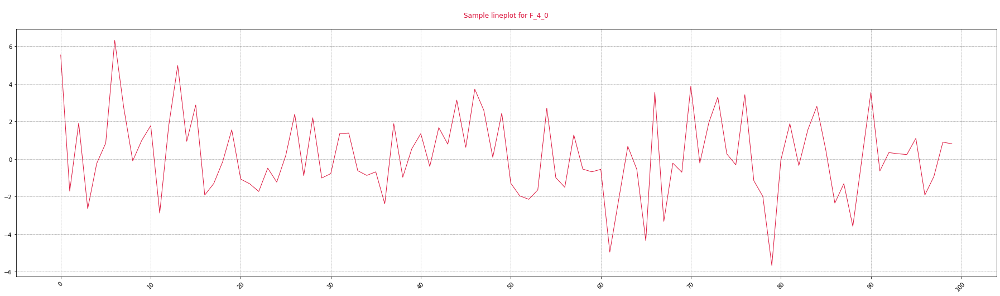

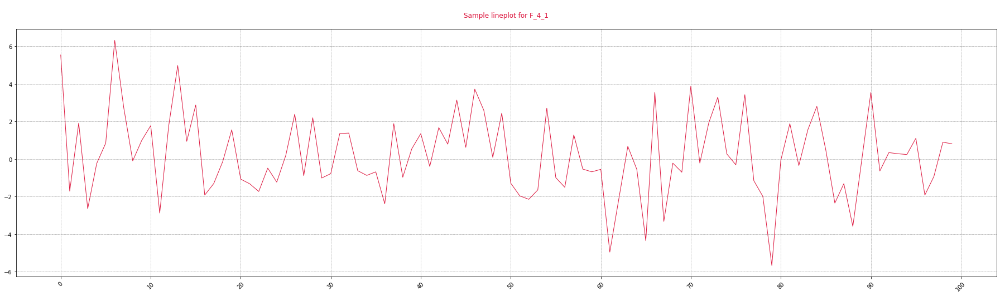

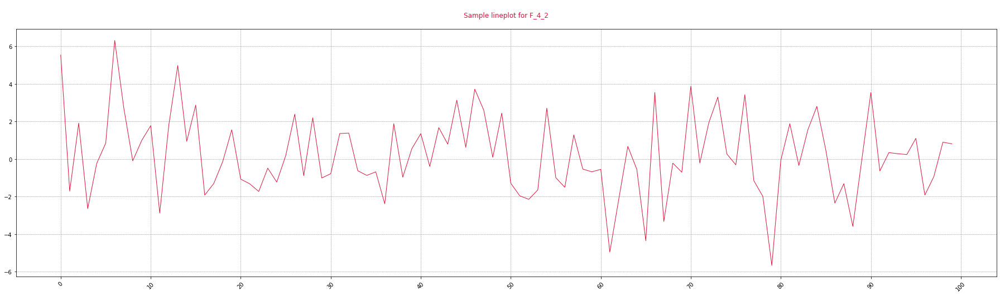

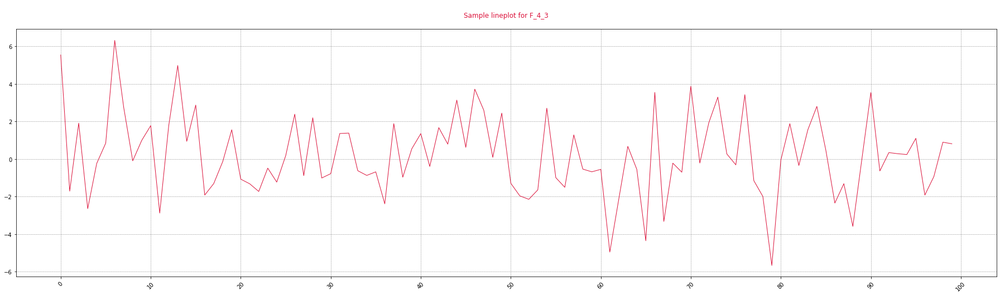

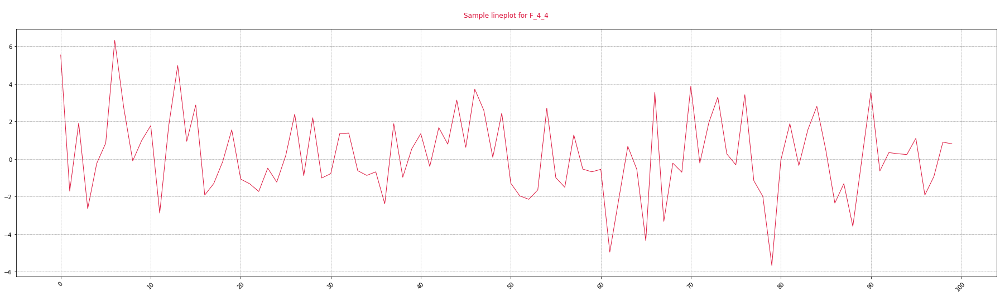

...

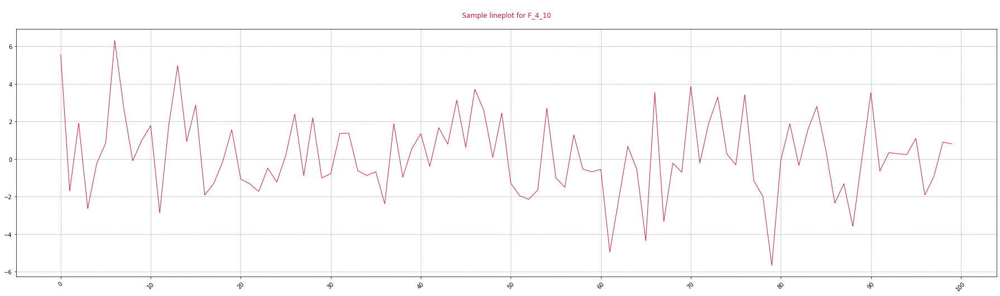

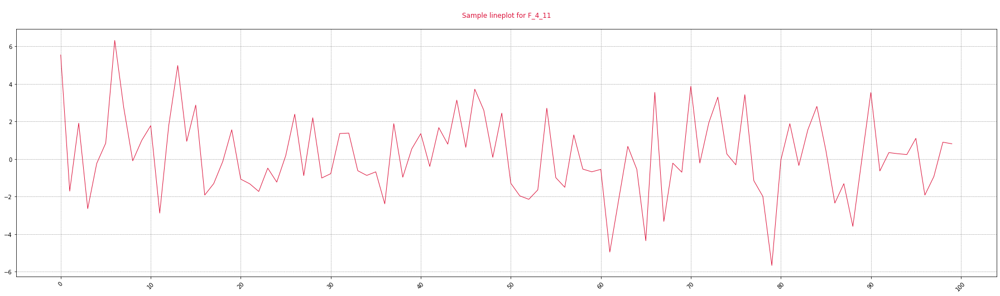

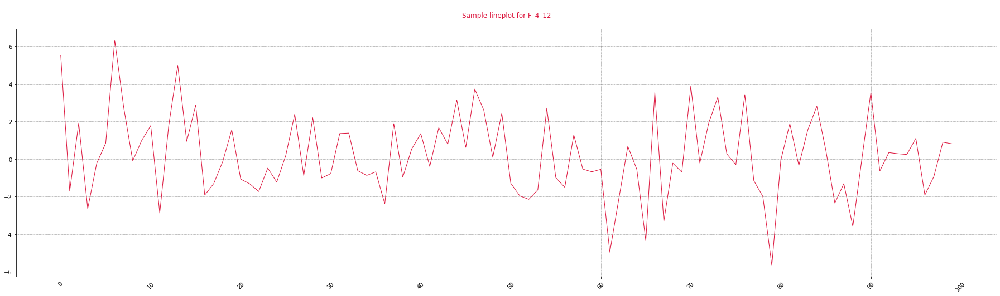

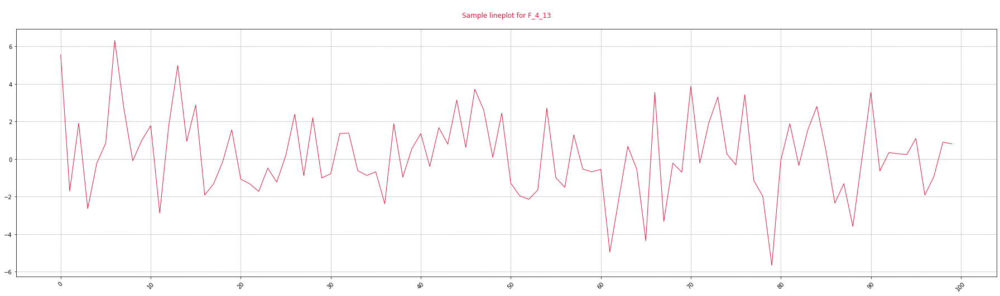

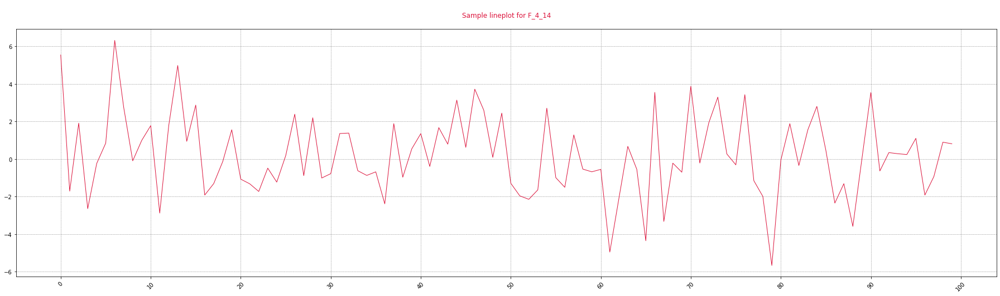


Current chunk size = 1000



  0%|          | 0/15 [00:00<?, ?it/s]

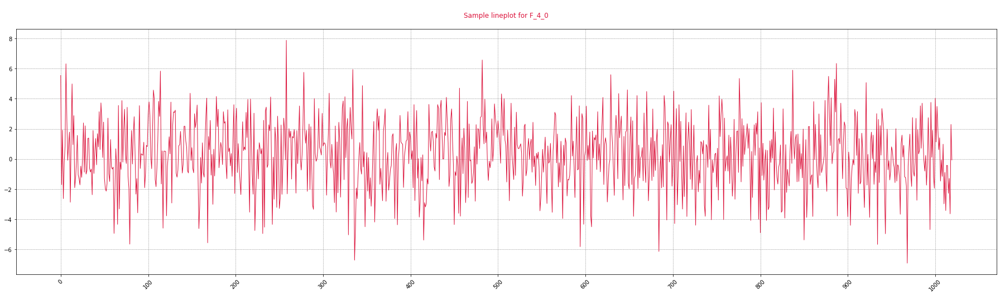

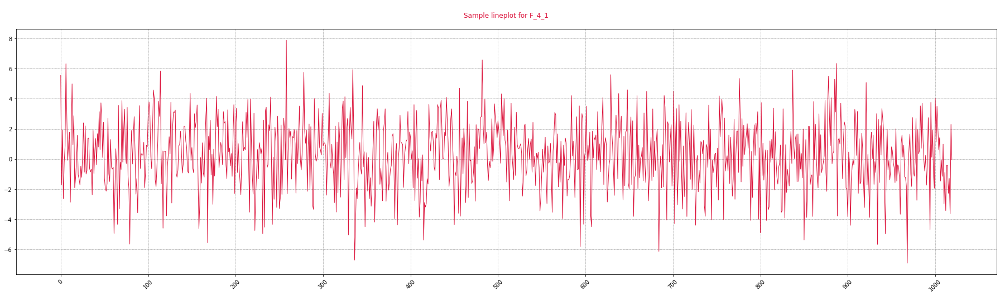

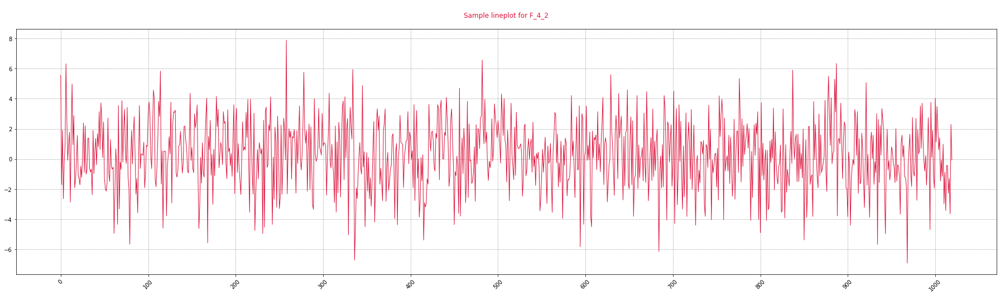

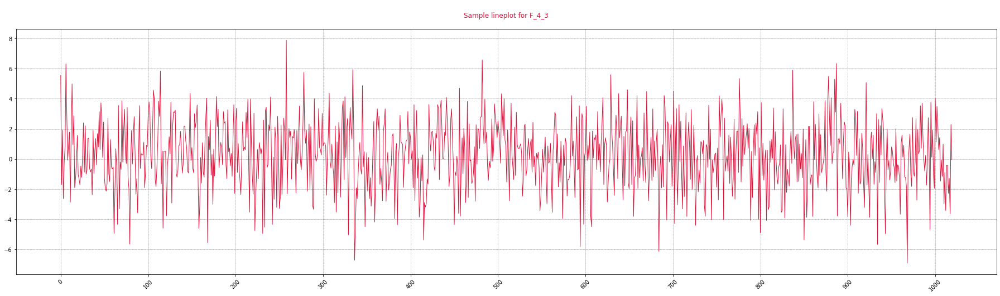

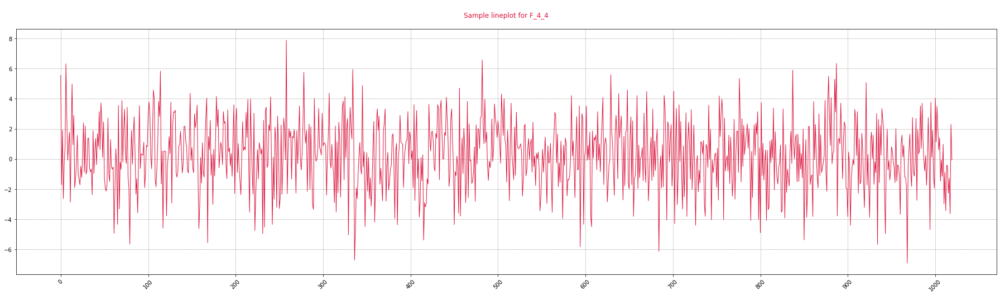

...

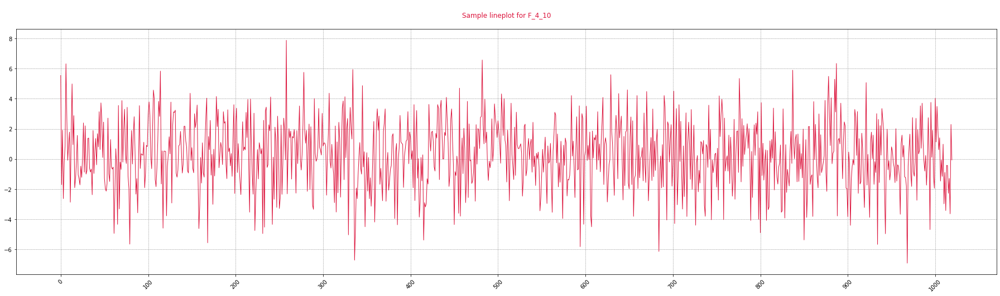

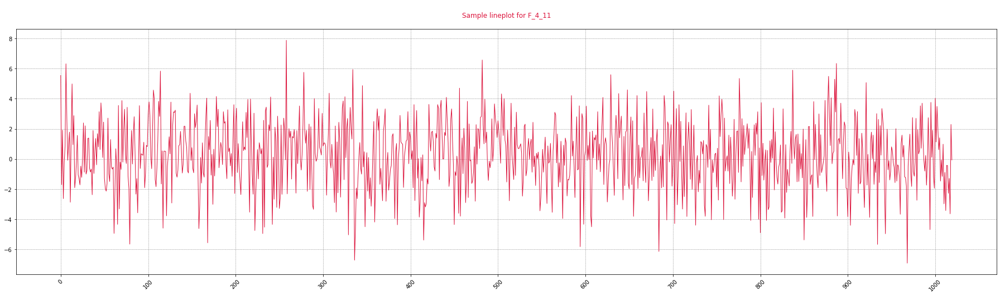

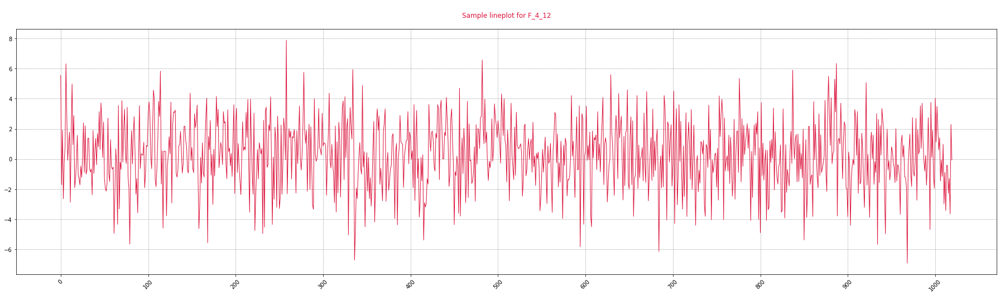

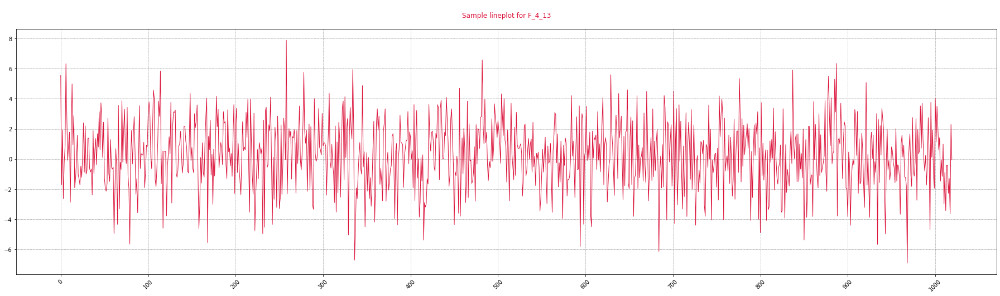

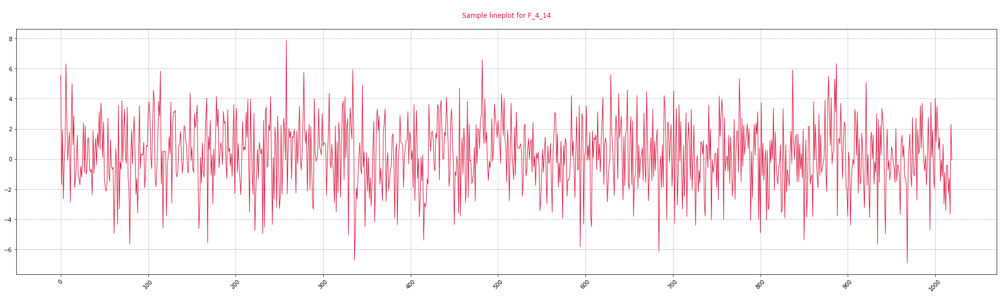


Current chunk size = 10000



  0%|          | 0/15 [00:00<?, ?it/s]

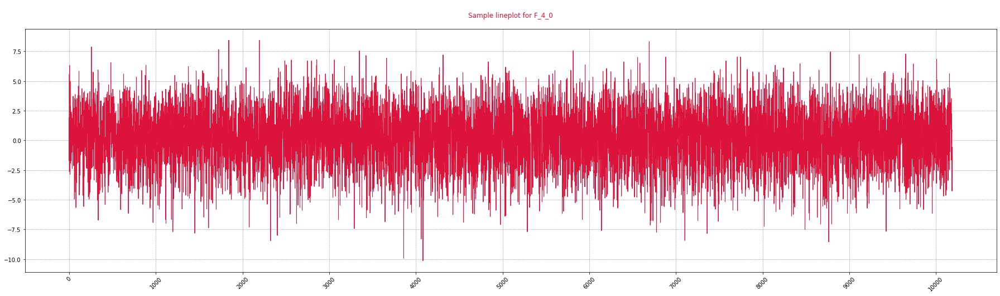

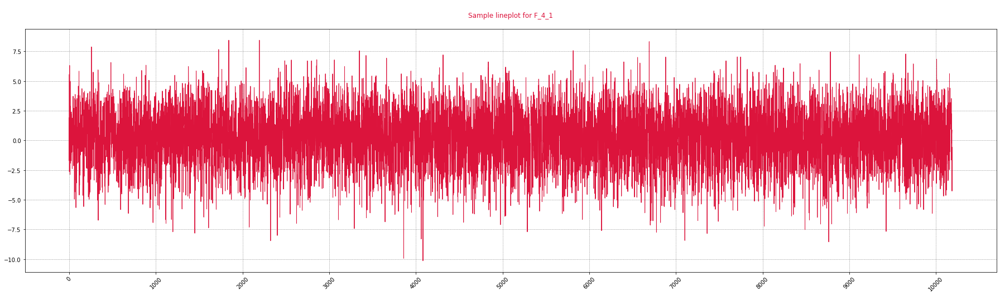

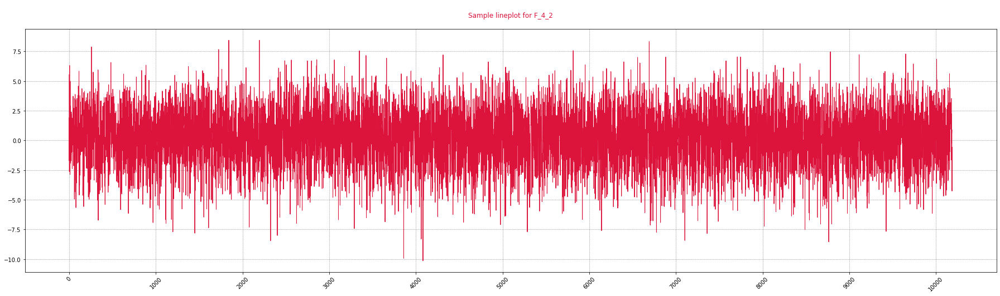

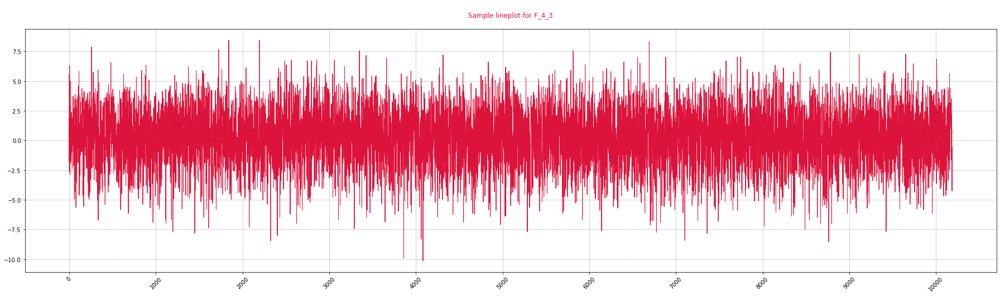

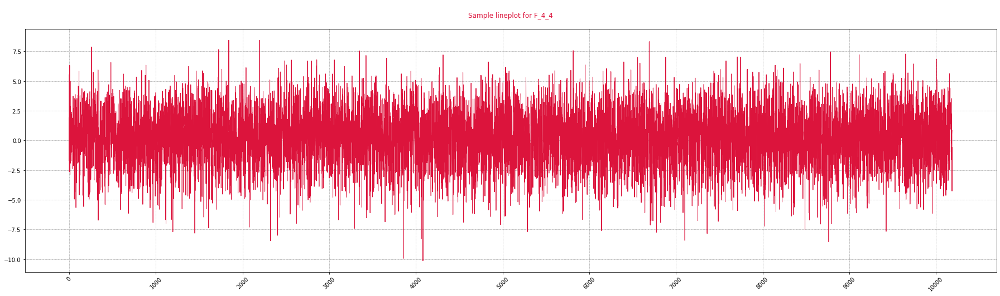

...

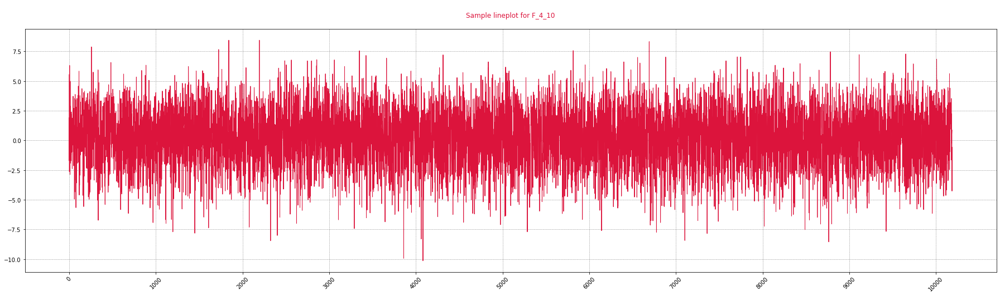

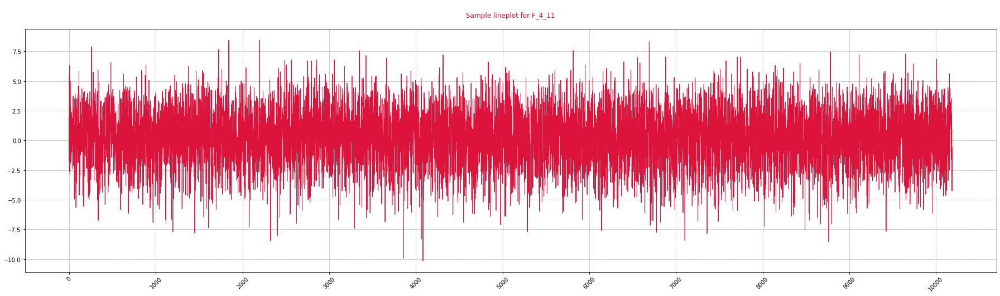

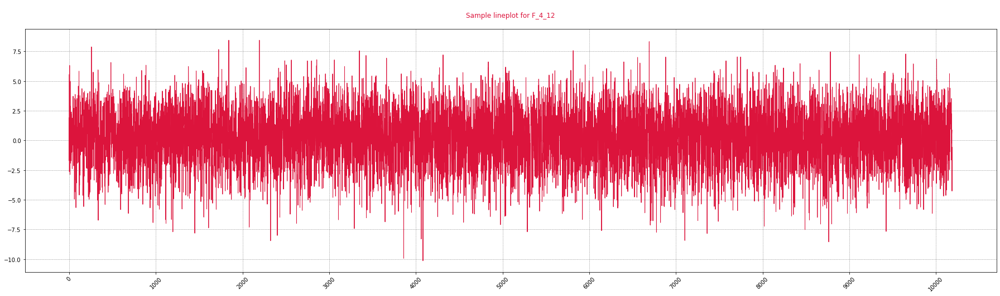

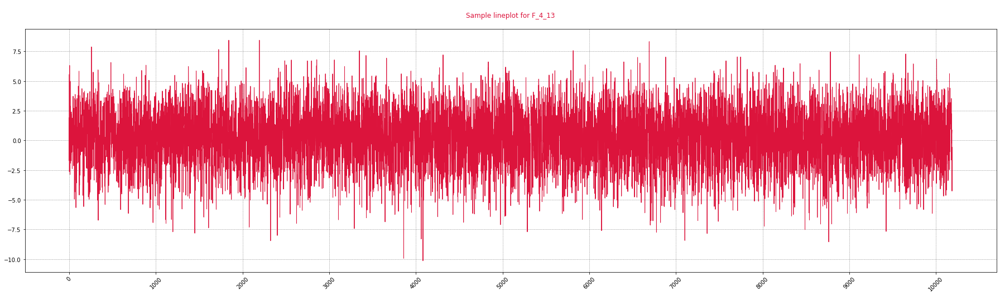

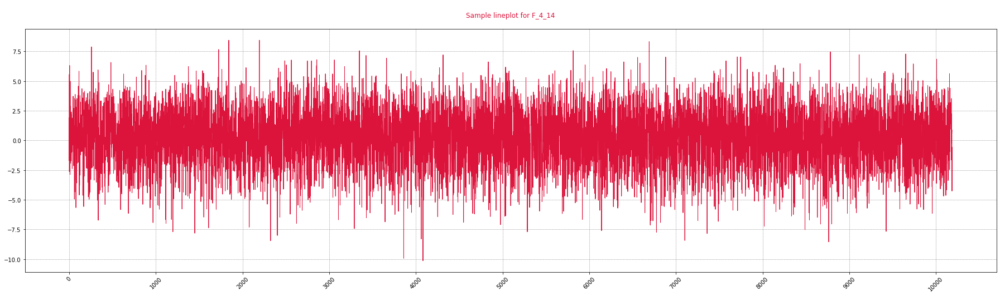

In [20]:
Plot_Ftre(grp_nb=1, color= 'crimson');
collect();

Feature group 3 lineplots



  0%|          | 0/3 [00:00<?, ?it/s]


Current chunk size = 100



  0%|          | 0/15 [00:00<?, ?it/s]

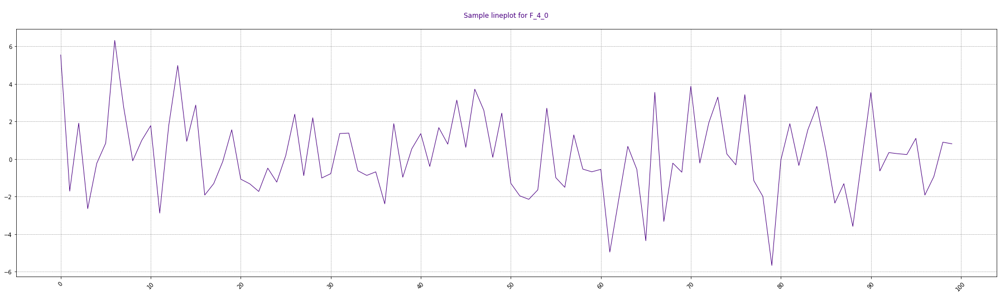

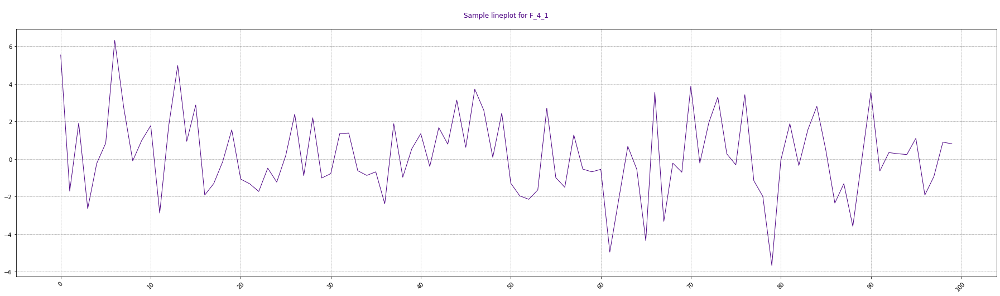

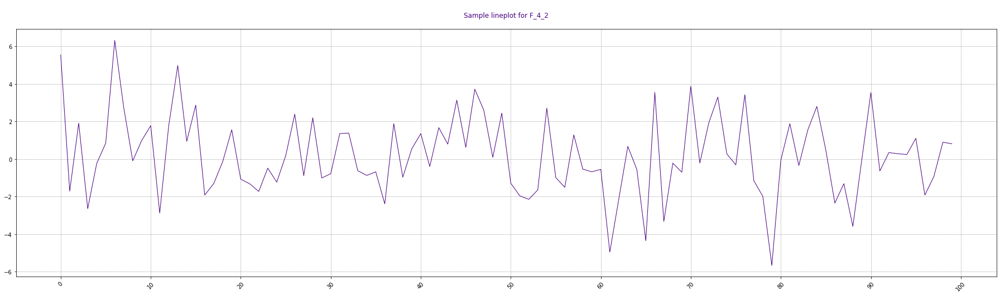

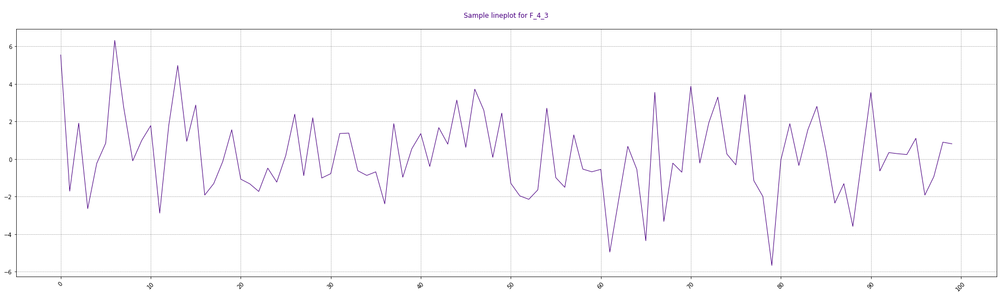

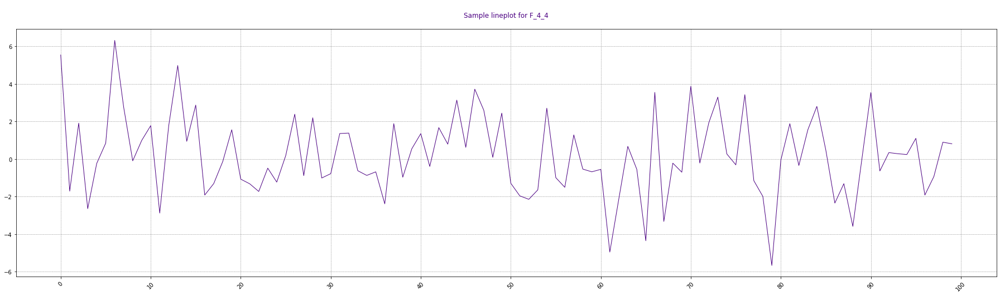

...

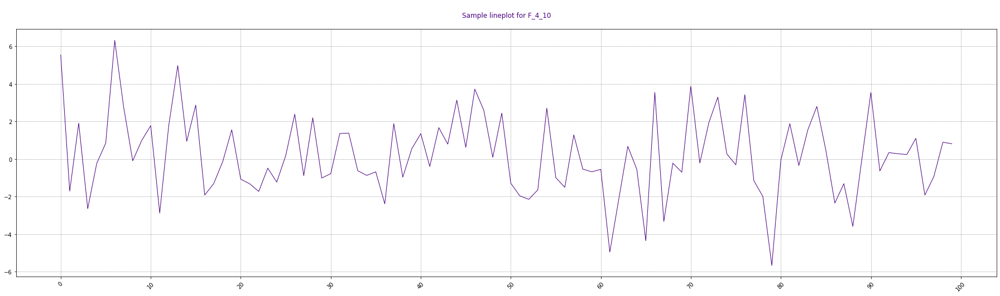

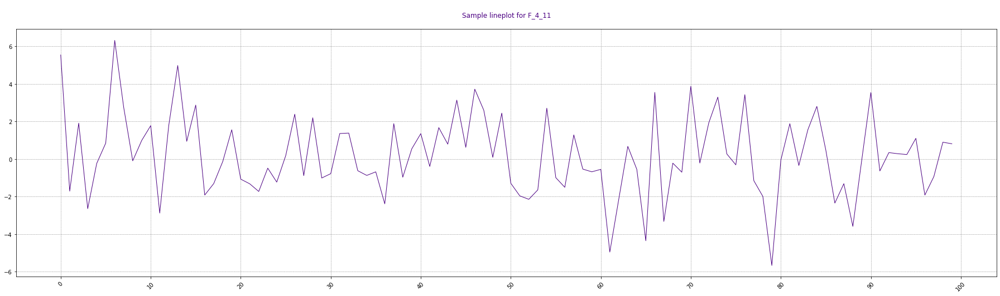

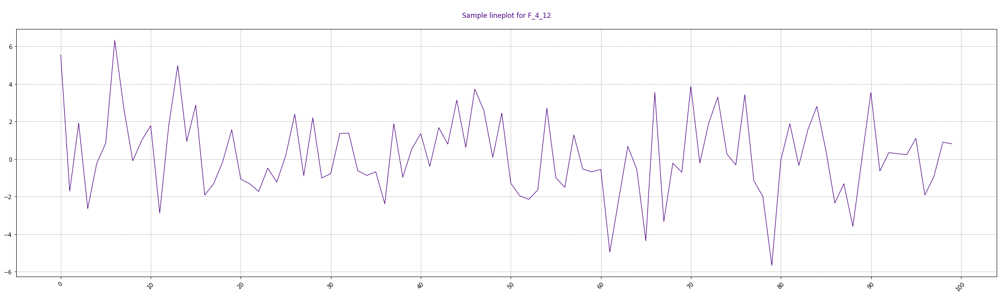

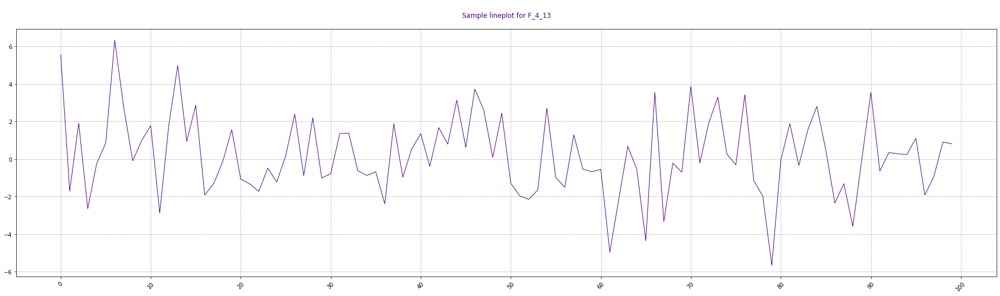

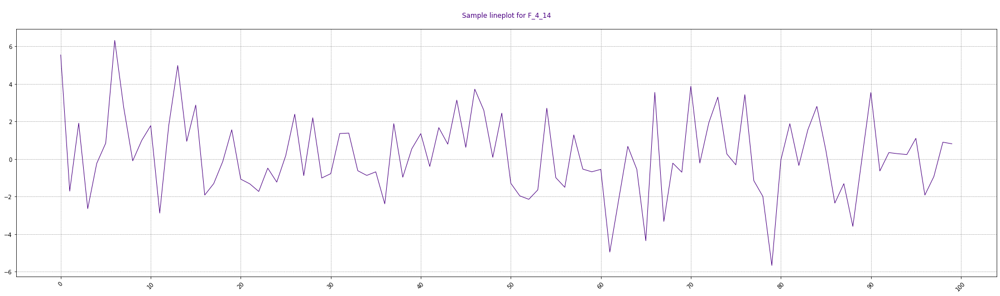


Current chunk size = 1000



  0%|          | 0/15 [00:00<?, ?it/s]

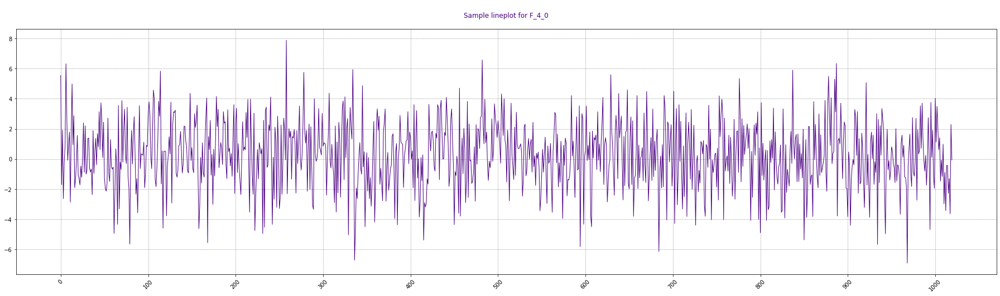

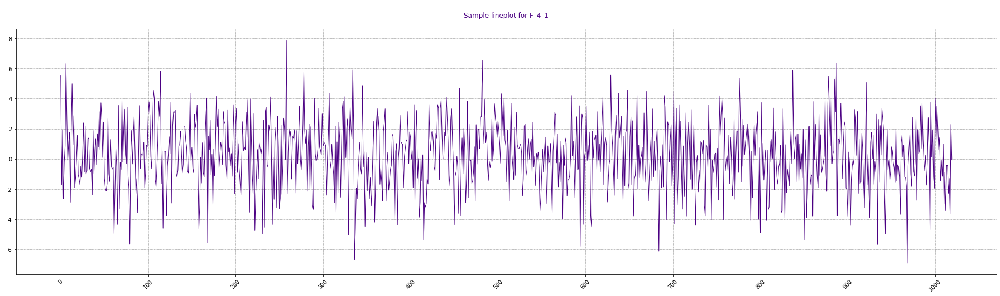

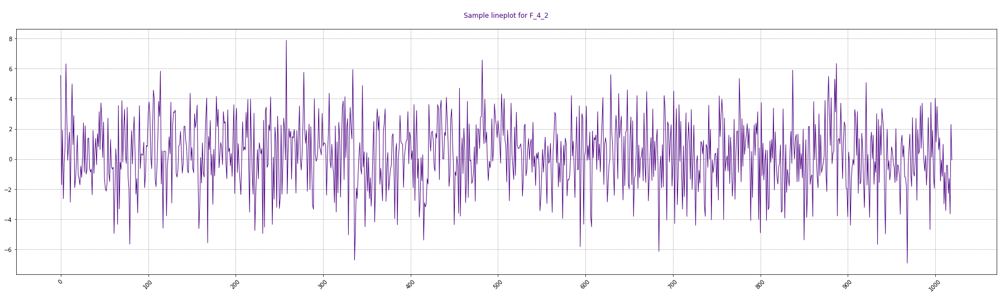

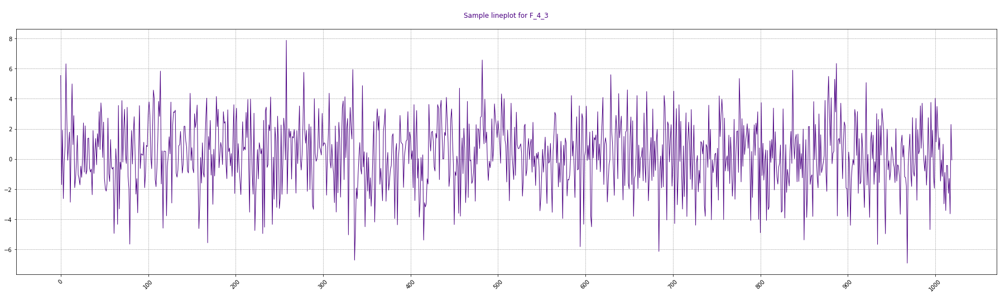

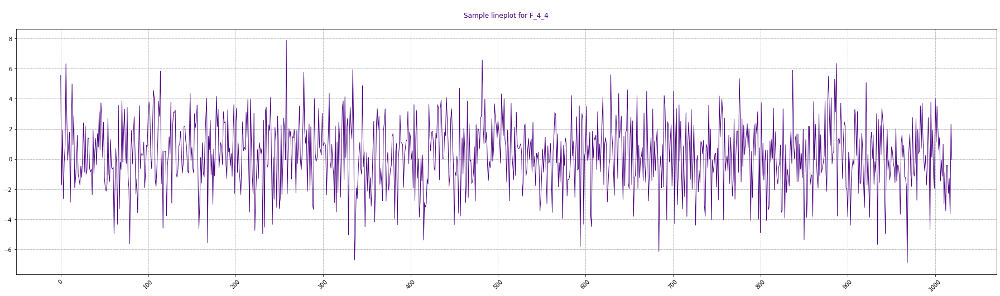

...

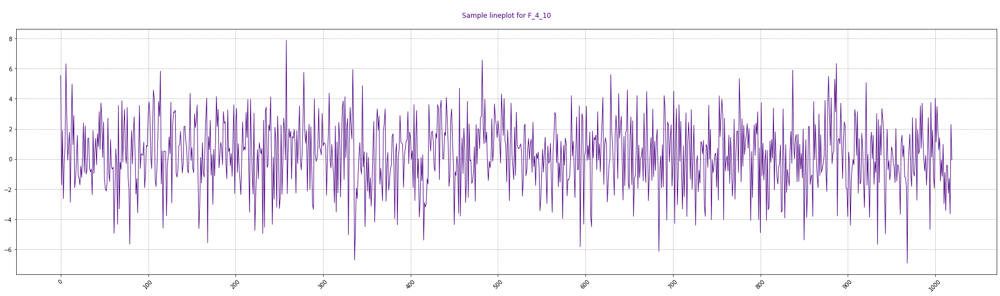

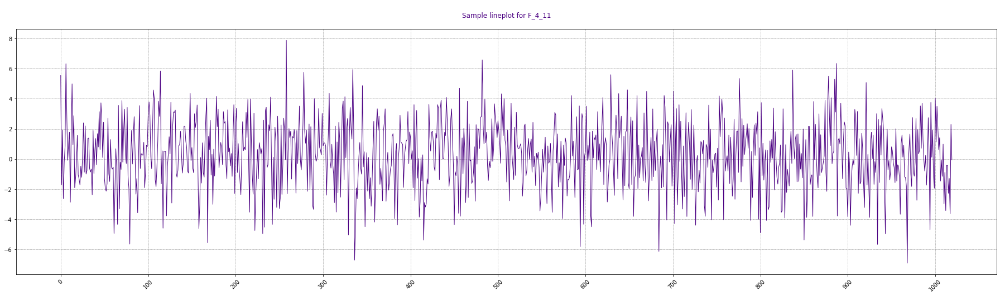

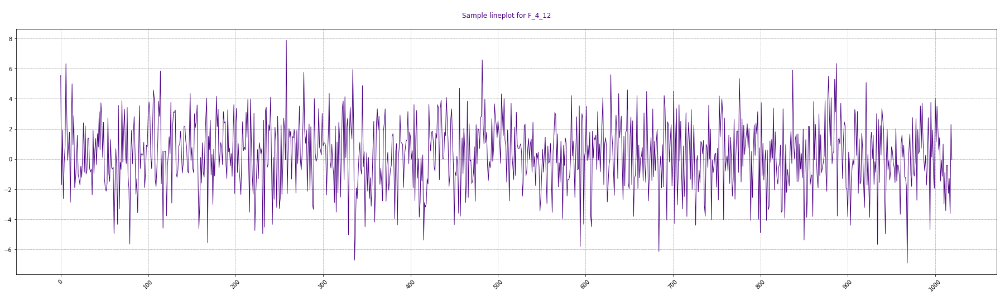

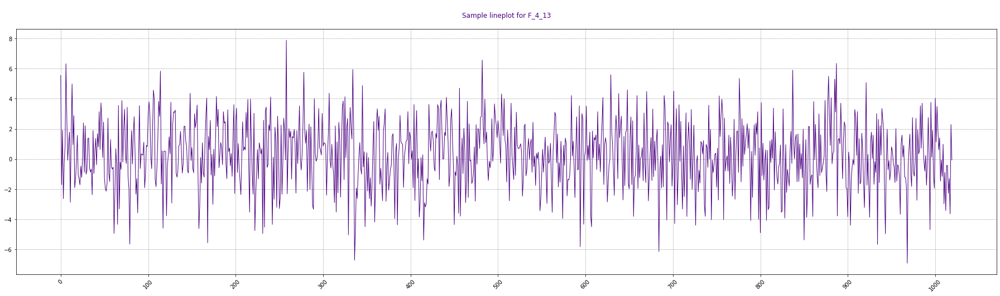

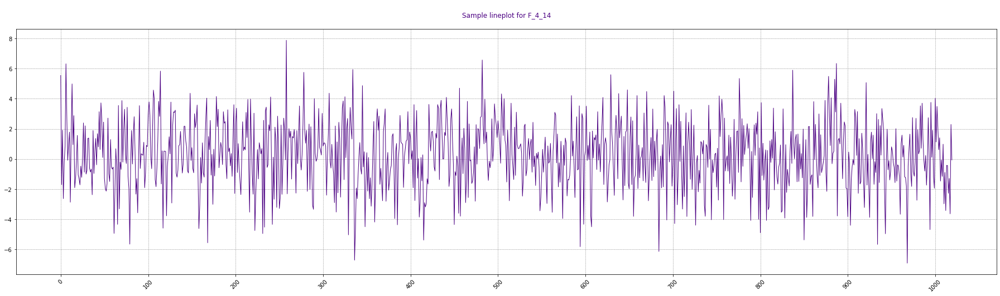


Current chunk size = 10000



  0%|          | 0/15 [00:00<?, ?it/s]

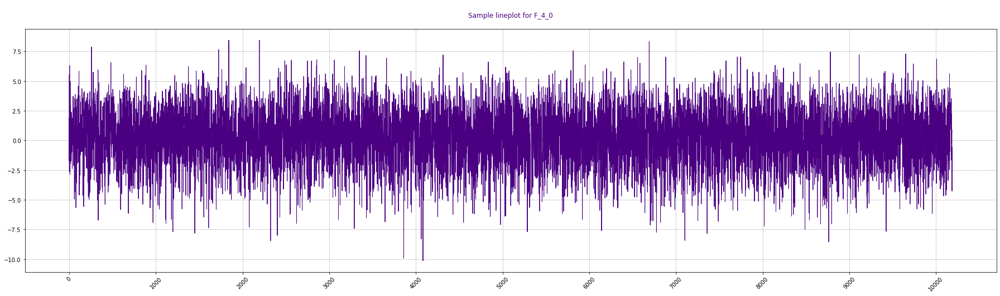

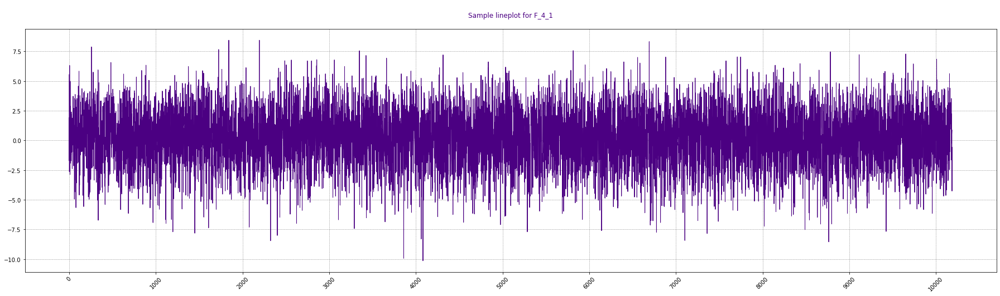

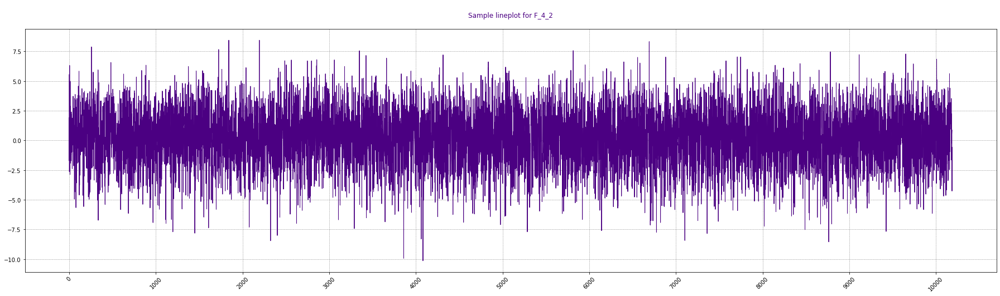

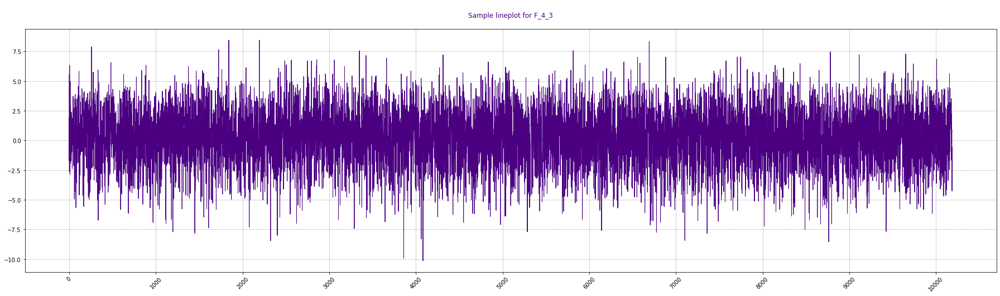

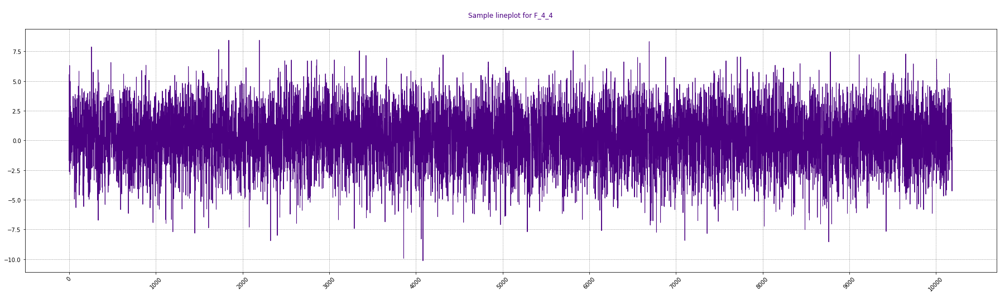

...

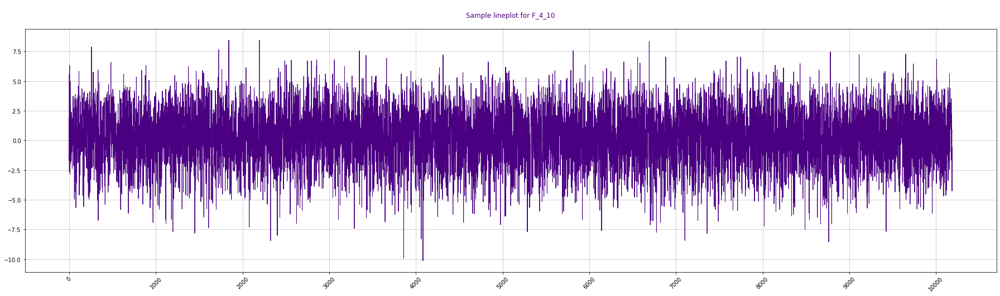

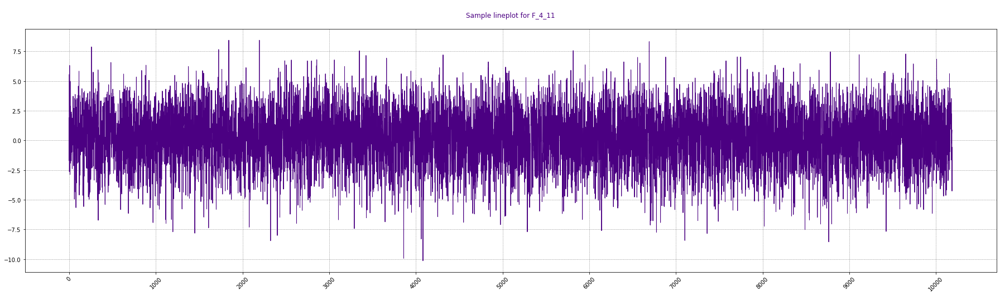

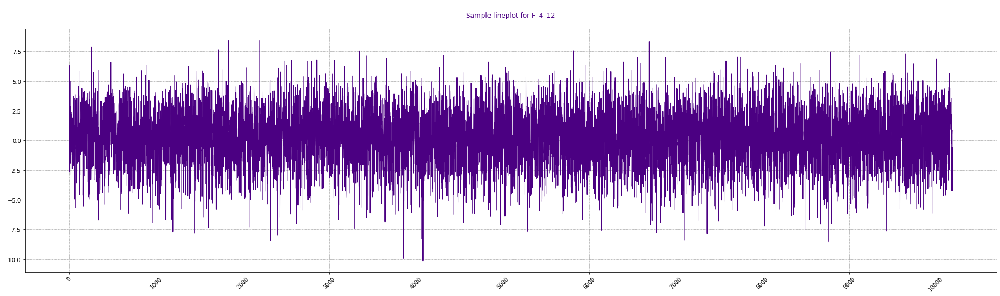

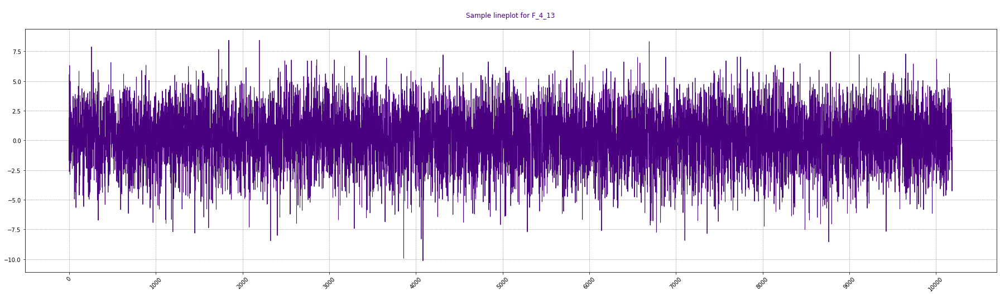

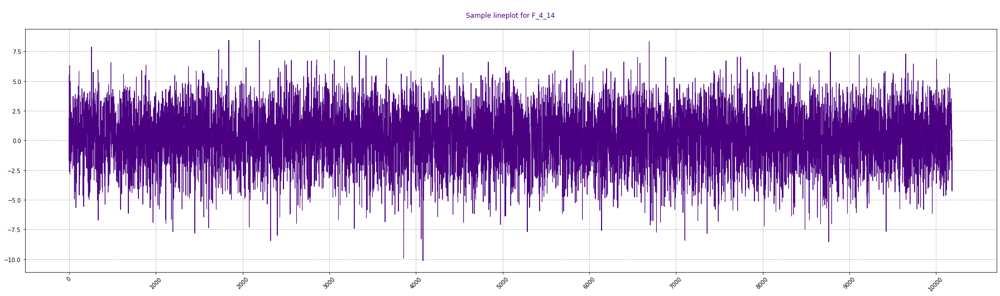

In [21]:
Plot_Ftre(grp_nb=3, color = 'indigo');
collect();

Feature group 4 lineplots



  0%|          | 0/3 [00:00<?, ?it/s]


Current chunk size = 100



  0%|          | 0/15 [00:00<?, ?it/s]

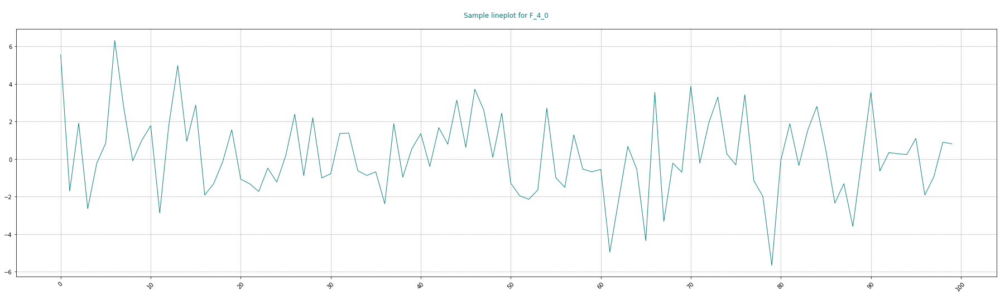

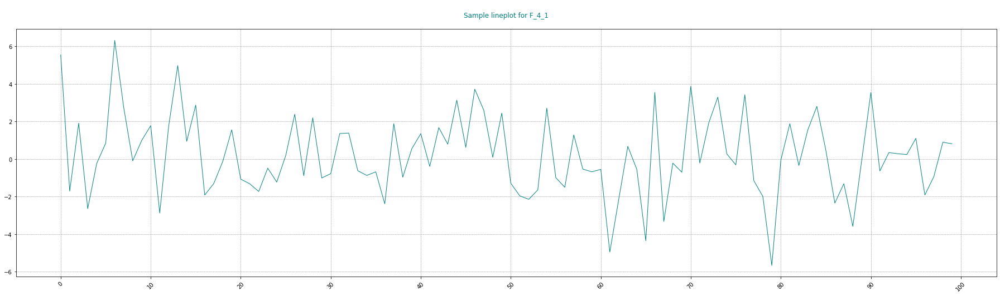

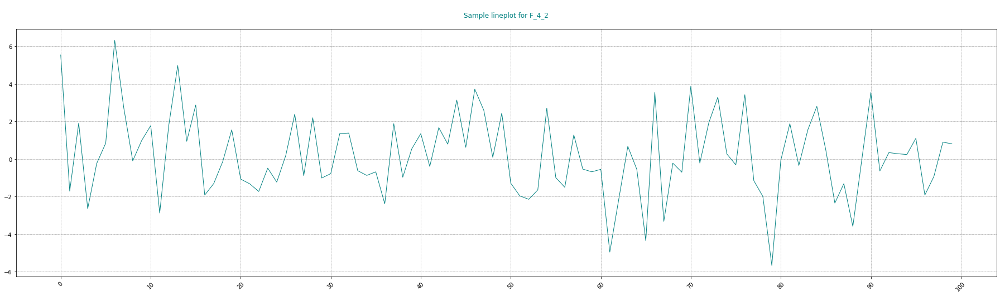

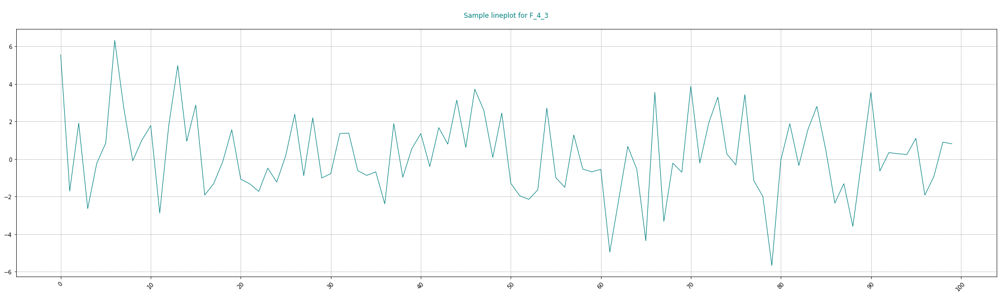

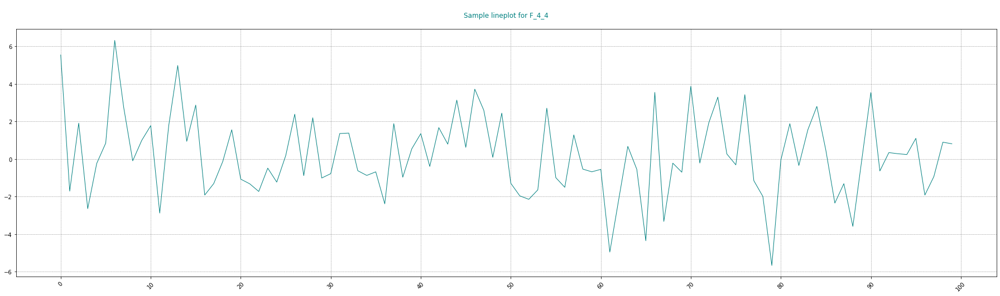

...

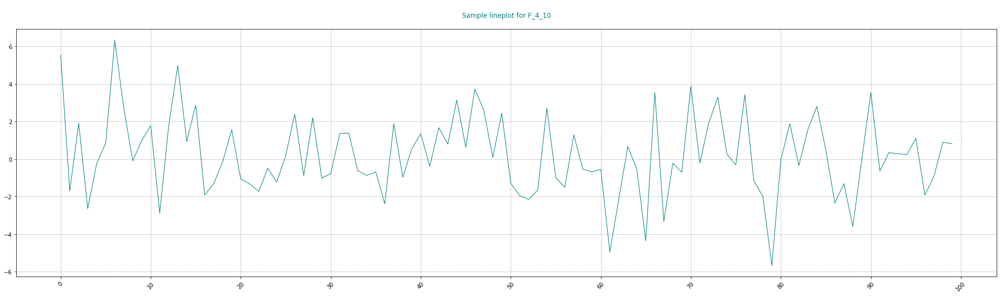

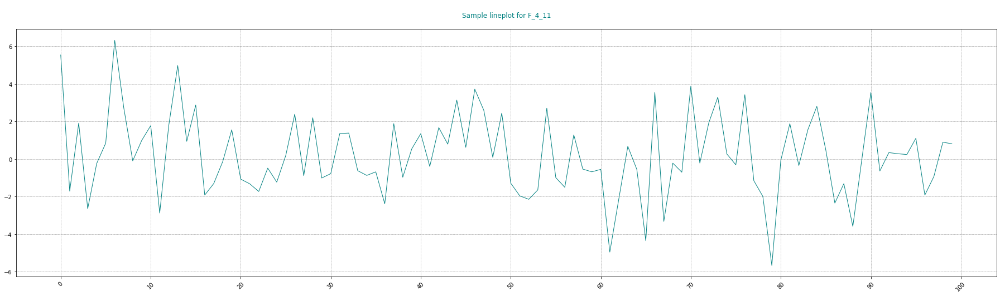

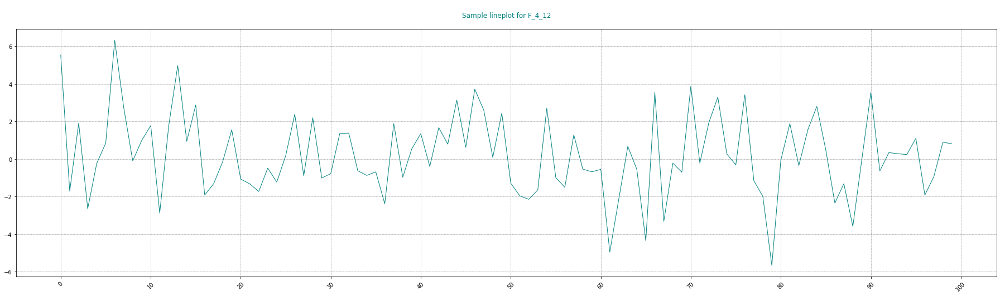

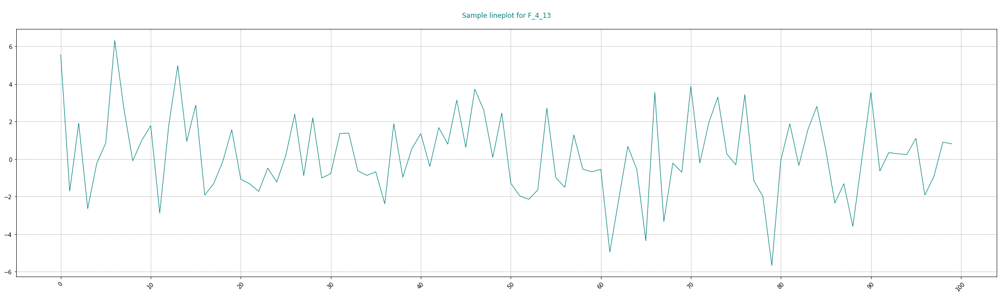

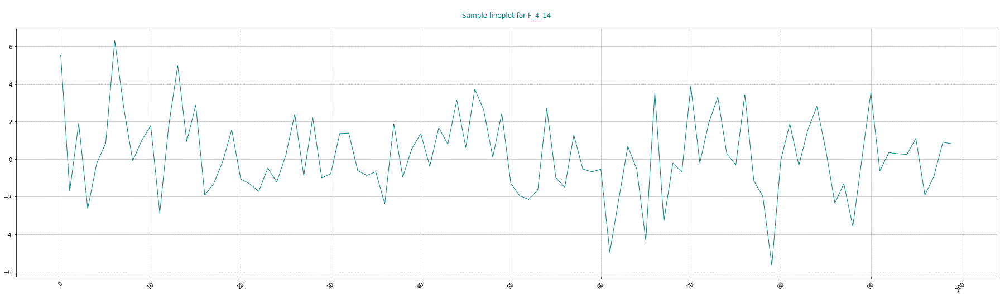


Current chunk size = 1000



  0%|          | 0/15 [00:00<?, ?it/s]

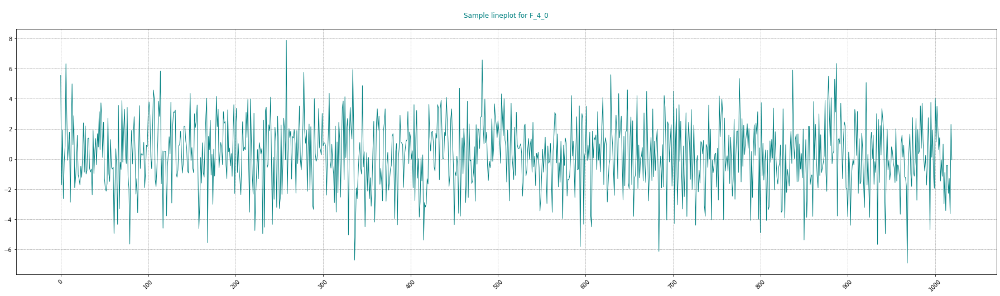

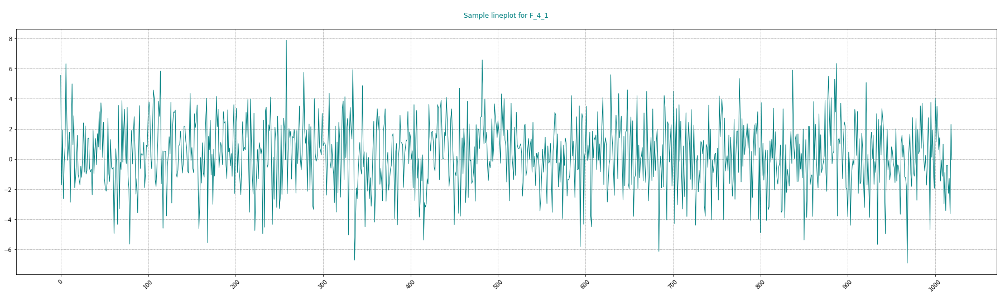

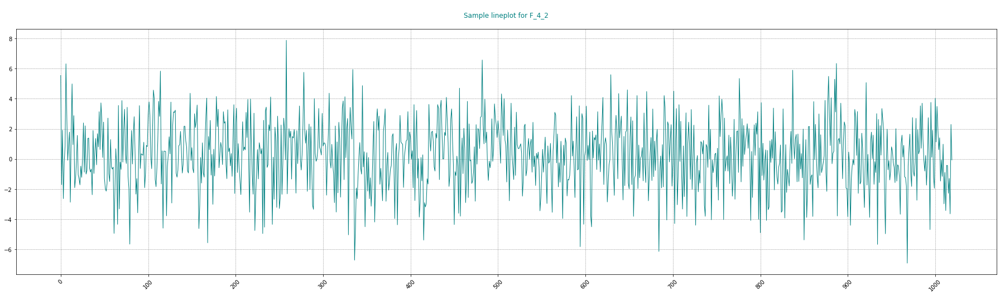

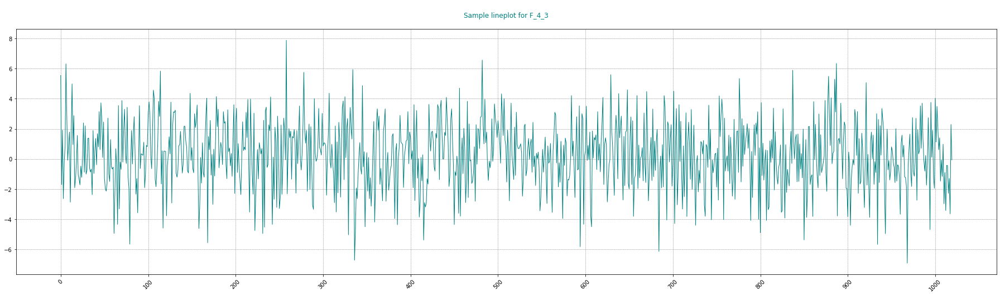

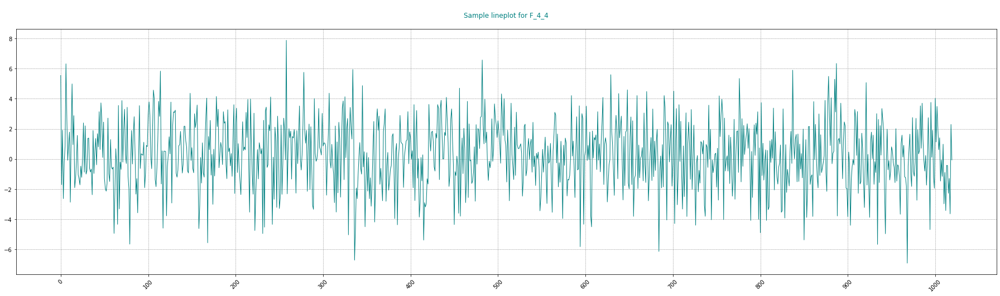

...

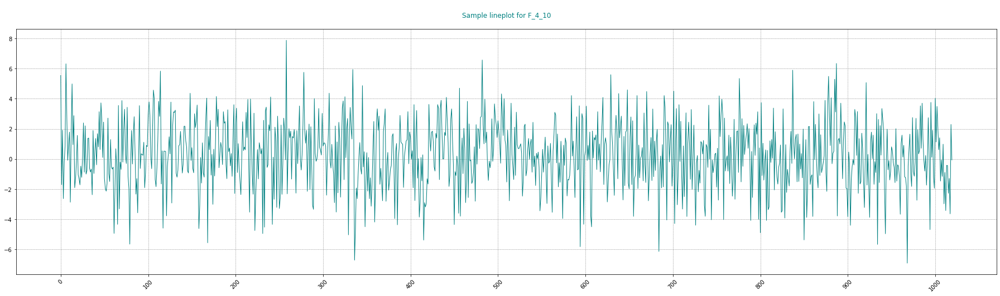

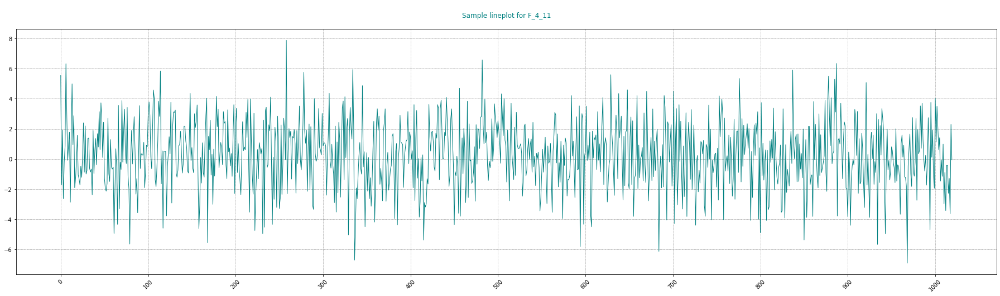

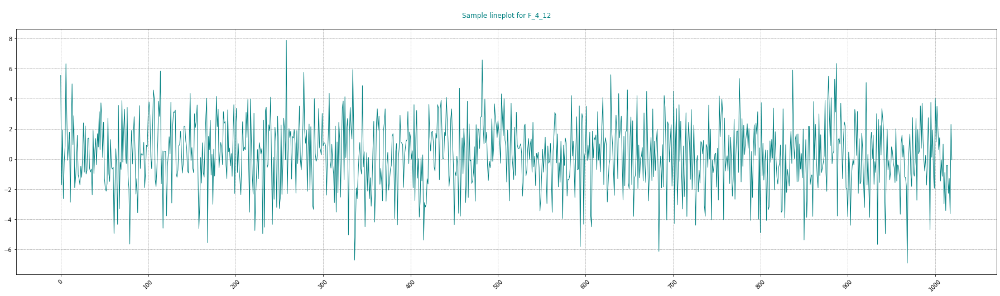

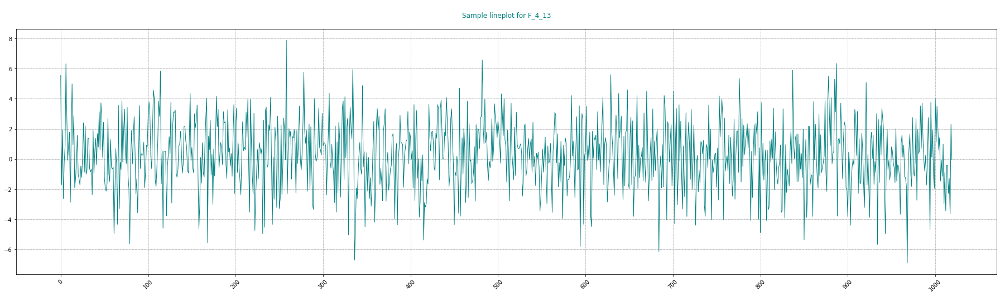

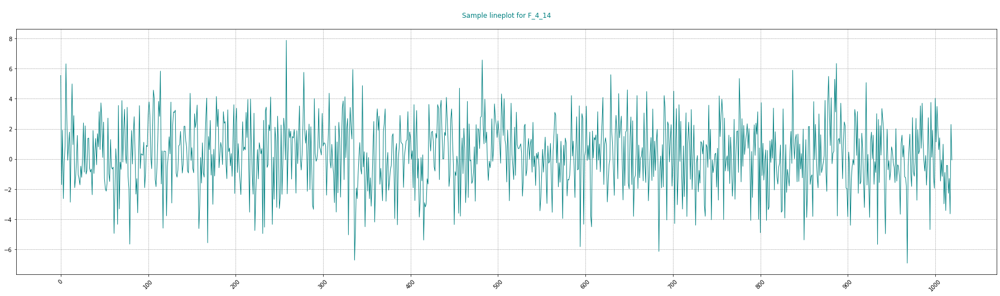


Current chunk size = 10000



  0%|          | 0/15 [00:00<?, ?it/s]

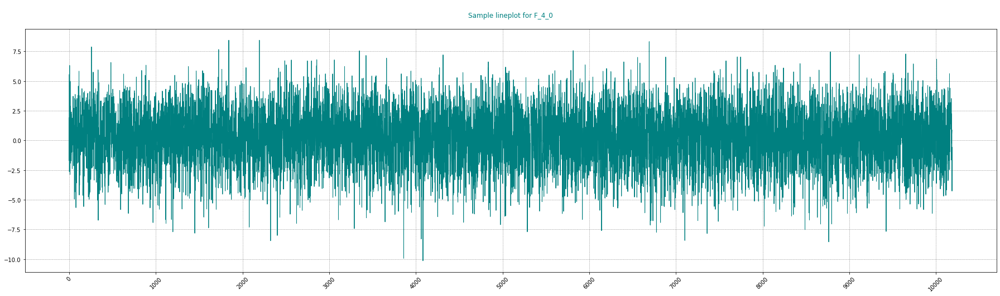

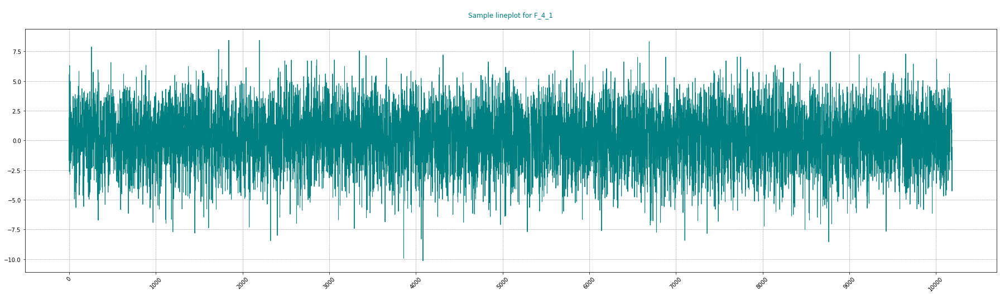

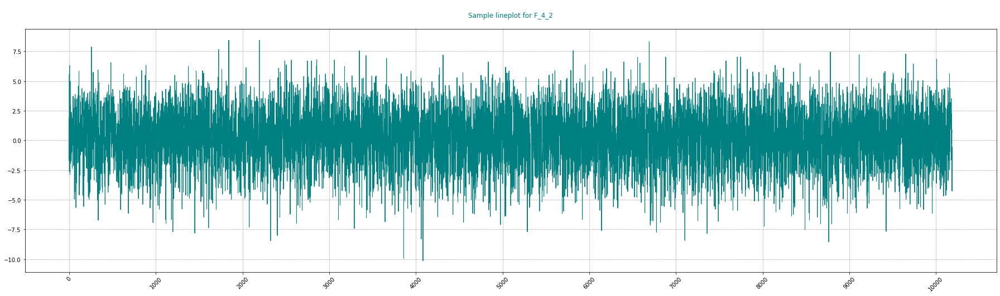

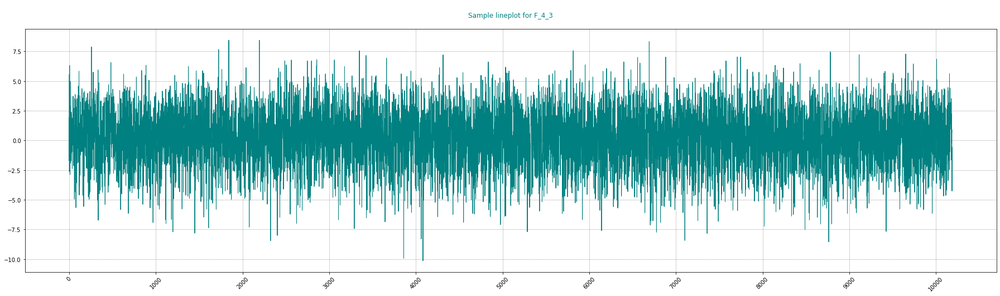

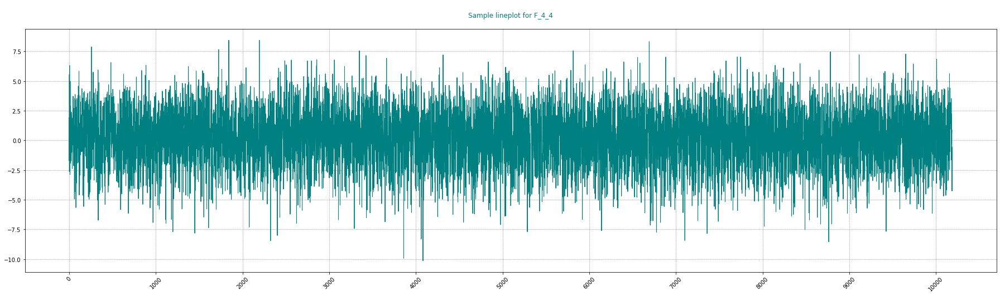

...

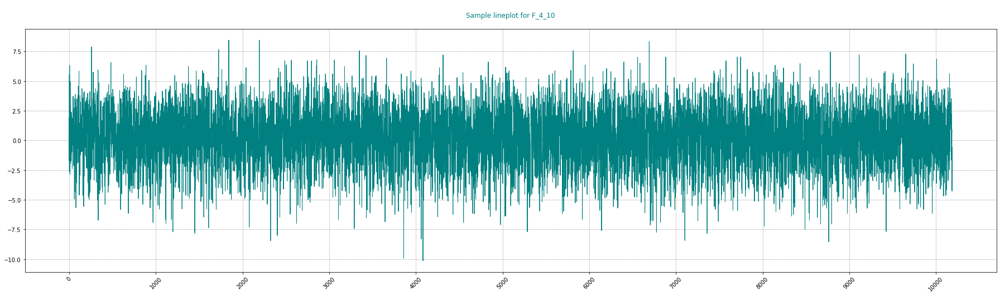

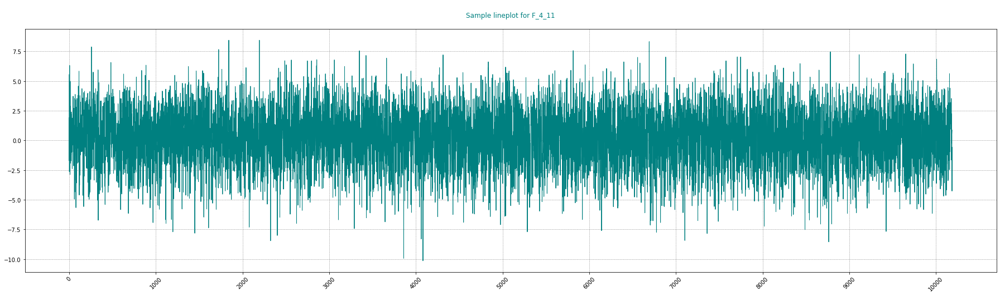

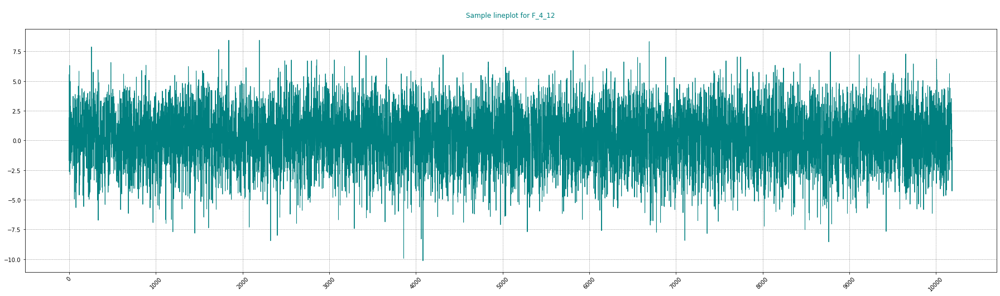

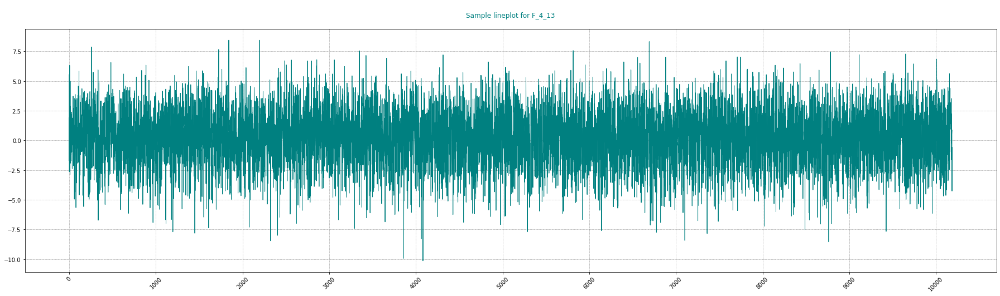

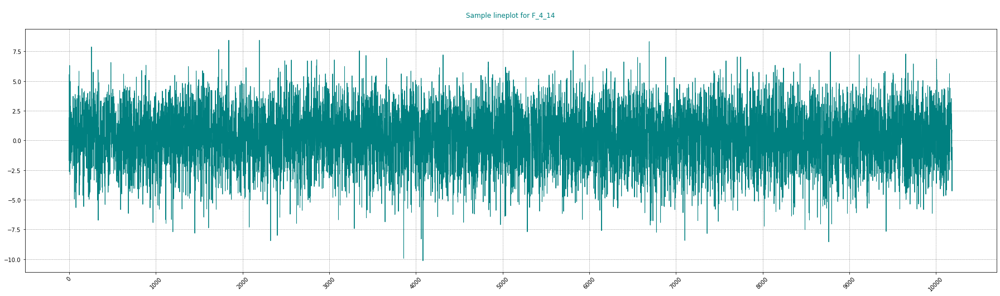

In [22]:
Plot_Ftre(grp_nb=4, color = 'teal');
collect();

  0%|          | 0/3 [00:00<?, ?it/s]

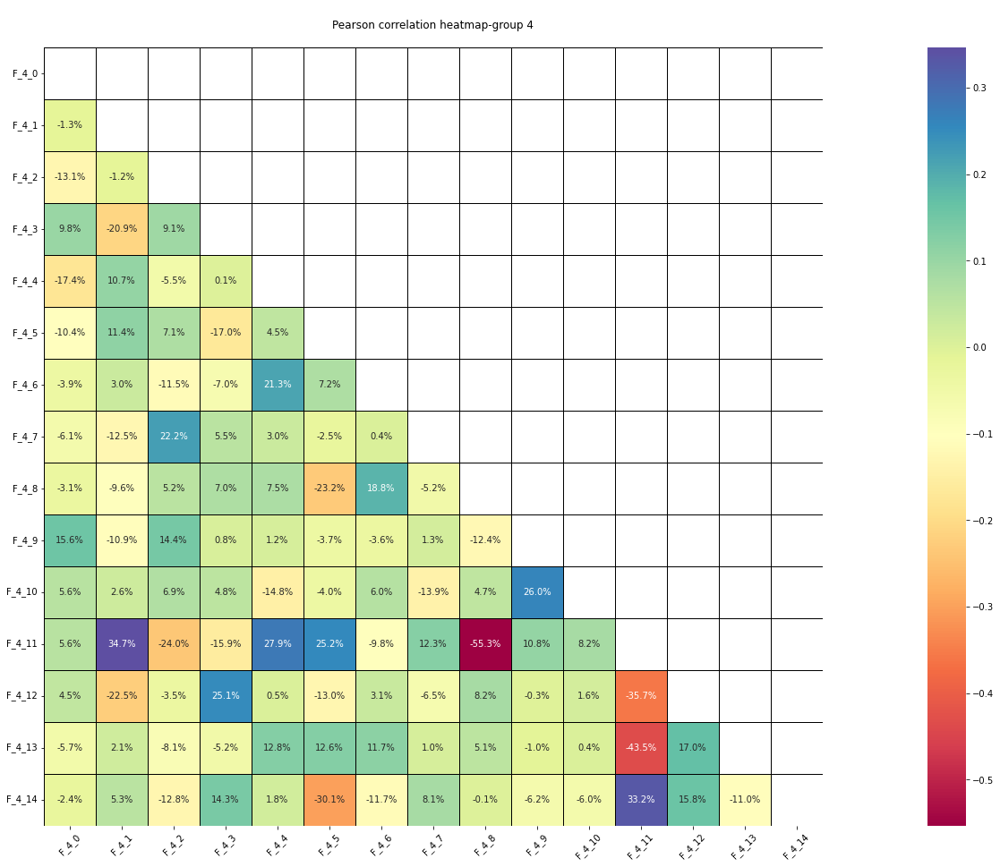

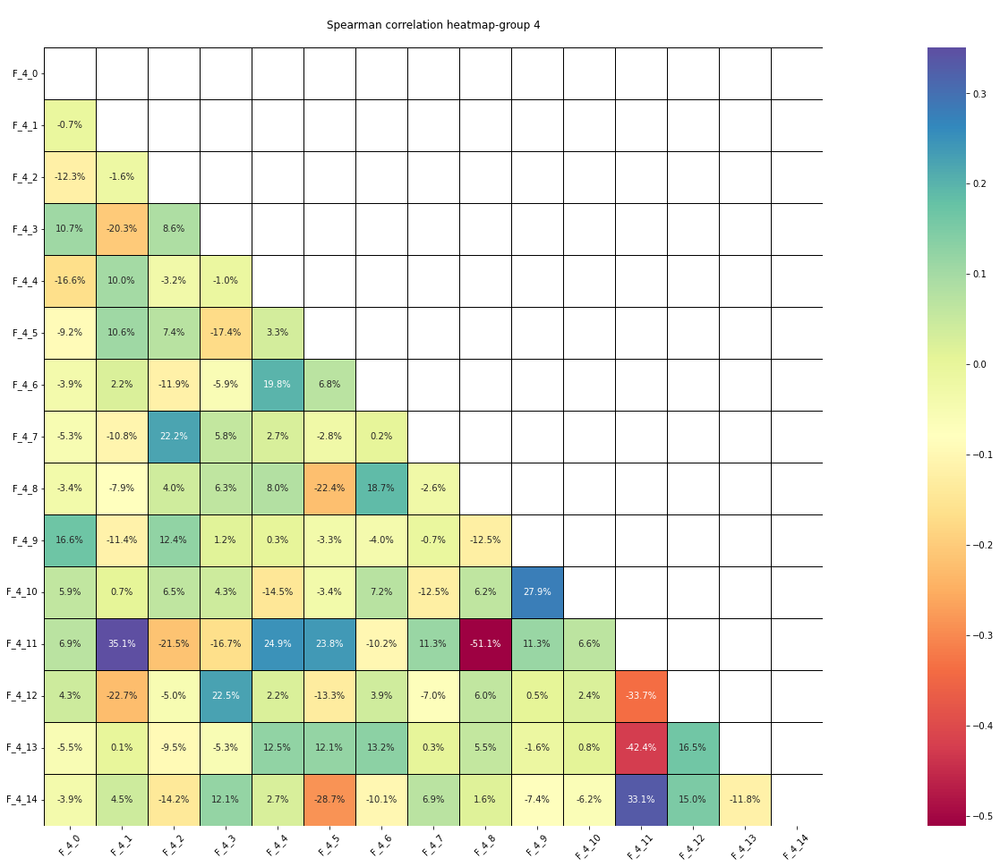

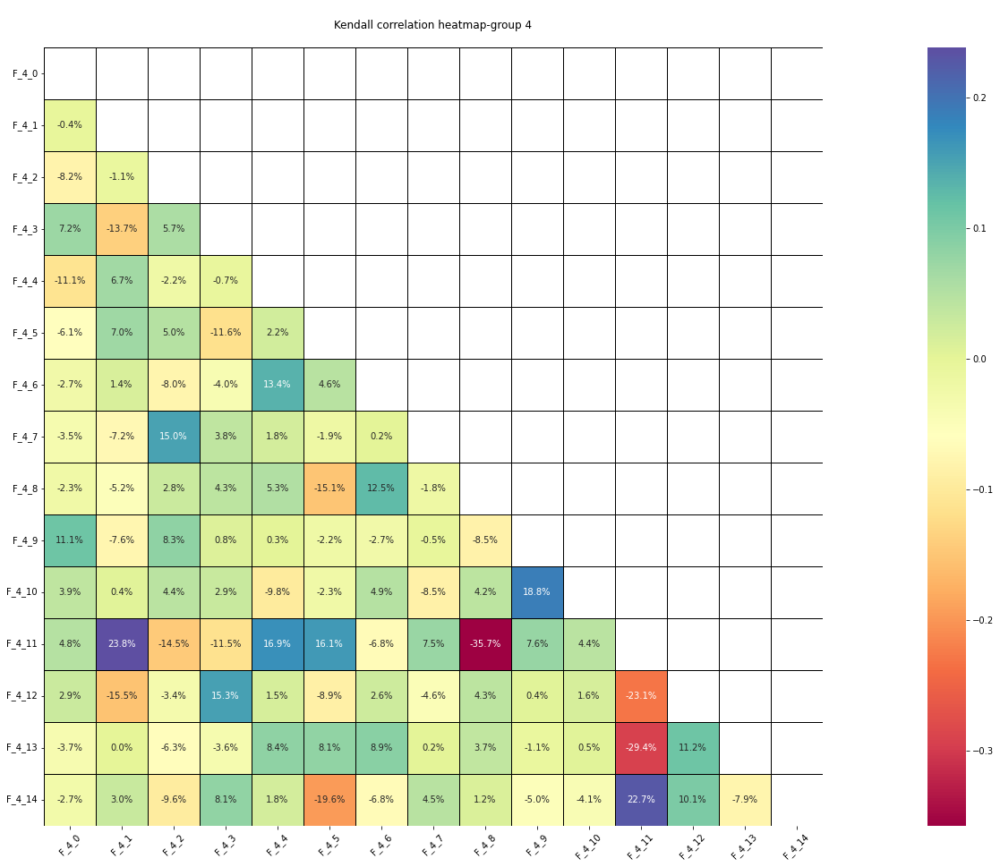

In [23]:
# Plotting correlation matrices across feature groups:-
for method in tqdm(['pearson', 'spearman', 'kendall']):
    _ = xytrain[Ftre_Grp_Dict[4]].corr(method= method);
    fig, ax= plt.subplots(1,1, figsize= (42,16));
    sns.heatmap(_,fmt=".1%", mask= np.triu(np.ones_like(_)),linewidths= 0.75,
                linecolor="black", square= True,cmap= 'Spectral', annot= True, ax= ax);   
    ax.set_title(f"\n{method.capitalize()} correlation heatmap-group 4\n", 
                 fontsize= 12, color= 'black');  
    plt.xticks(rotation= 45);
    plt.yticks(rotation= 0);
    plt.show();
    del _;

collect();